In [1]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from astropy import units as u
from astropy.coordinates import SkyCoord
from astropy.io import fits
from spectral_cube import SpectralCube
from astropy.convolution import Gaussian1DKernel, convolve
#import aplpy 
from astropy.wcs import WCS
from astropy.time import Time
import pandas as pd
import os

mpl.rcParams['font.family'] = 'serif'
mpl.rcParams['font.size'] = '16'
mpl.rcParams['xtick.direction'] = 'in'
mpl.rcParams['ytick.direction'] = 'in'
%matplotlib inline

In [6]:
def plot_spectra_hydra(atca_file):
    cube = SpectralCube.read('/Users/Denes/Research/High_lat_HI/ATCA_data/data_cubes_v2/hydra/{}'.format(atca_file))  # Open the FITS file for reading
    
    atca = fits.open('/Users/Denes/Research/High_lat_HI/ATCA_data/data_cubes_v2/hydra/{}'.format(atca_file))  # Open the FITS file for reading
    d_atca = atca[0].data
    h_atca = atca[0].header
    w_atca = WCS(h_atca, atca)
    
    d_atca = d_atca[0,:,:,:] # cut polarization axix
    d_atca_av = np.mean(d_atca, axis=0)  # average cube along the velocity axis
    
    # rms and maximum of the image
    print('max image:', np.max(d_atca_av))
    rms = np.sqrt(np.mean(d_atca_av**2))
    print('rms:', rms)
    
    d_atca_av_2 = np.copy(d_atca_av)
    
    d_atca_av_2[d_atca_av_2 < 5*rms] = 'nan'
    
    signal = np.where(d_atca_av_2 > 0)
    print(signal[0])
 
    # plot average data cube image
    fig = plt.figure(figsize=(12,5))
    
    ax = fig.add_subplot(1,2,1)
    plt.title('{}'.format(atca_file[:12]), fontsize=30)
    plt.imshow(d_atca_av)
    ax.set_xlabel('RA', size=18,family='serif')
    ax.set_ylabel('Dec', size=18,family='serif')
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    
    ax = fig.add_subplot(1,2,2)
    plt.title('{}'.format(atca_file[:12]), fontsize=30)
    plt.imshow(d_atca_av_2)
    ax.set_xlabel('RA', size=18,family='serif')
    ax.set_ylabel('Dec', size=18,family='serif')
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)

    fig.savefig('/Users/Denes/Research/High_lat_HI/ATCA_data/maps/{}_map.png'.format(atca_file[:-5]))
    
    c_atca = SkyCoord(ra=h_atca['CRVAL1'], dec=h_atca['CRVAL2'], unit=(u.deg, u.deg))
    pixels_atca = c_atca.to_pixel(w_atca)
    g = Gaussian1DKernel(2.0)
    
    spectrum = cube[:, int(pixels_atca[1]), int(pixels_atca[0])] 
    rms_spect = np.sqrt(np.mean(spectrum**2))
    print('rms spectrum', rms_spect)
    print('max spectrum', np.max(spectrum))

    # replacing the spectral line with the rms to fit the continuum
    spectrum_2 = np.copy(spectrum)
    spectrum_2[spectrum_2 < rms_spect - (np.max(spectrum)-rms_spect) ] = rms_spect

    plt.plot(spectrum)
    plt.plot(spectrum_2)

    vel = cube.spectral_axis
    y = spectrum_2
    x = vel.value/1000
    pars = np.polyfit(x, y, 1)
    p = np.poly1d(pars)

    hismooth = convolve(spectrum, g, boundary='extend')
    tauhi_smooth = hismooth/p(vel.value/1000)
    rms_smooth = np.sqrt(np.mean(tauhi_smooth**2))
    tauhi = spectrum/p(vel.value/1000)
    tauhi = np.array(tauhi)
    tau = np.log(tauhi) * -1.
    std_tauhi = np.std(tauhi)

    #tauhi = hismooth/p(hiv)
    minustauhi = 1. - tauhi

    fig = plt.figure(figsize=(18, 12))
    ax = fig.add_subplot(111)
    plt.title('{}'.format(atca_file[:12]), fontsize=30)
    plt.plot(vel/1000, tauhi, linewidth=3, alpha=0.8, color='gray')
    plt.plot(vel/1000, tauhi_smooth, linewidth=3, color='C1')
    ax.axhspan(1-std_tauhi, 1+std_tauhi, alpha=0.2, color='green')

    plt.axhline(1, color='k', linestyle='--', linewidth=2)
    #plt.axvline(0, color='grey', linestyle='--')
    plt.grid(color='grey', linestyle='--')
    #ax.axhspan(1-rms_smooth, 1+rms_smooth, alpha=0.5, color='lightgrey')
    #ax.axvspan(-10, 3, alpha=0.2, color='green')
    plt.ylabel(r'e$^{-\tau}$', fontsize=28)
    plt.xlabel("v [km/s]", fontsize=28)
    #plt.xlim(-40,40)
    ax.tick_params(axis='both', which='major', labelsize=25)
    fig.savefig('/Users/Denes/Research/High_lat_HI/ATCA_data/spectra_plots/{}_spectra.png'.format(atca_file[:-5]))
    
    df_spectra_tauhi = pd.DataFrame()
    df_spectra_tauhi['velocity'] = vel/1000
    df_spectra_tauhi['Amplitude'] = tauhi
    df_spectra_tauhi.to_csv('./spectra/hydra/{}_atca_spectrum_tauhi.txt'.format(atca_file[:-5]), sep='\t')
    
    df_spectra = pd.DataFrame()
    df_spectra['velocity'] = vel/1000
    df_spectra['Amplitude'] = spectrum
    df_spectra.to_csv('./spectra/hydra/{}_atca_spectrum.txt'.format(atca_file[:-5]), sep='\t')


max image: 0.17199501
rms: 0.0038665934
[59 60 60 61 61 61 61 62 62 62 62 63 63 63 63 64 64 64 65 65 65 65 66 66
 66 66 67 67 67 67 68 68 69]
rms spectrum 0.10456220805644989 Jy / beam
max spectrum 0.1308685541152954 Jy / beam


max image: 0.8199292
rms: 0.01787851
[ 60  60  61  61  61  61  62  62  62  62  63  63  63  63  64  64  64  64
  64  65  65  65  65  65  66  66  66  66  67  67  67  68  68 102 103]
rms spectrum 0.5319098234176636 Jy / beam
max spectrum 0.604927659034729 Jy / beam


max image: 0.38729542
rms: 0.008764607
[60 61 61 61 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66
 66 66 66 67 67 67 68 68]
rms spectrum 0.22795064747333527 Jy / beam
max spectrum 0.29037368297576904 Jy / beam


max image: 0.9224535
rms: 0.019693844
[60 60 61 61 61 61 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65
 65 66 66 66 66 67 67 67 67 68 68]
rms spectrum 0.6242930293083191 Jy / beam
max spectrum 0.7173235416412354 Jy / beam


max image: 0.44232726
rms: 0.010179561
[60 60 60 61 61 61 62 62 62 63 63 63 64 64 64 65 65 65 66 66 66 67 67 67
 68 68 68]
rms spectrum 0.23515760898590088 Jy / beam
max spectrum 0.3299475908279419 Jy / beam


max image: 0.735577
rms: 0.015584119
[60 60 61 61 61 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65
 66 66 66 66 67 67 67 68 68]
rms spectrum 0.44786450266838074 Jy / beam
max spectrum 0.5487302541732788 Jy / beam


max image: 0.1974294
rms: 0.006550194
[ 60  61  61  61  62  62  62  63  63  63  63  64  64  64  64  65  65  65
  65  66  66  66  67  67  67  68  68 110]
rms spectrum 0.1140570119023323 Jy / beam
max spectrum 0.17006702721118927 Jy / beam


max image: 0.6513634
rms: 0.014196332
[60 61 61 61 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66
 66 66 66 67 67 67 68 68]
rms spectrum 0.39283156394958496 Jy / beam
max spectrum 0.46395689249038696 Jy / beam


max image: 0.09349683
rms: 0.004646141
[ 0  0  0  1  1  1  2  2  2  3  3  3  4  4  4  5  5  5  5  6  6  6  7  7
  7  8  8  9  9 58 59 59 59 60 60 60 61 61 62 62 62 63 63 63 64 64 64 65
 65 65 65 66 66 66 67 67 67 68 68 69 69]
rms spectrum 0.056727826595306396 Jy / beam
max spectrum 0.13549679517745972 Jy / beam


<ipython-input-6-7fc1cdac92f6>:72: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


max image: 0.2090458
rms: 0.0057177385
[60 60 61 61 61 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65
 66 66 66 66 67 67 67 68 68]
rms spectrum 0.13393861055374146 Jy / beam
max spectrum 0.2137109637260437 Jy / beam


max image: 0.2987667
rms: 0.007946576
[60 60 61 61 61 62 62 62 62 63 63 63 63 64 64 64 64 64 65 65 65 65 66 66
 66 66 67 67 67 68 68]
rms spectrum 0.20769621431827545 Jy / beam
max spectrum 0.28149357438087463 Jy / beam


<ipython-input-6-7fc1cdac92f6>:25: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(12,5))


max image: 0.18419129
rms: 0.004300666
[33 34 35 35 36 36 37 59 60 60 60 61 61 61 62 62 62 62 63 63 63 63 64 64
 64 64 65 65 65 65 66 66 66 66 67 67 67 67 68 68 68 69]
rms spectrum 0.1279786080121994 Jy / beam
max spectrum 0.17234884202480316 Jy / beam


max image: 0.17327324
rms: 0.0068889754
[56 57 57 58 58 59 59 60 60 61 61 61 62 62 62 63 63 63 64 64 64 65 65 66
 66 67 67 67 68 68 68 69 69 70 71]
rms spectrum 0.07474633306264877 Jy / beam
max spectrum 0.13342687487602234 Jy / beam


max image: 0.6581592
rms: 0.014316496
[60 60 61 61 61 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65
 66 66 66 66 66 67 67 67 68 68]
rms spectrum 0.399026483297348 Jy / beam
max spectrum 0.4895930290222168 Jy / beam


max image: 0.37603852
rms: 0.008328577
[60 60 61 61 61 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65
 66 66 66 66 67 67 67 67 68 68]
rms spectrum 0.23476853966712952 Jy / beam
max spectrum 0.30731526017189026 Jy / beam


max image: 0.17014208
rms: 0.005307033
[61 61 61 62 62 62 62 63 63 63 63 64 64 64 64 64 65 65 65 65 65 65 65 66
 66 66 66 66 66 67 67 67 67 67 67 68 68 68 69 69]
rms spectrum 0.11068986356258392 Jy / beam
max spectrum 0.17134909331798553 Jy / beam


max image: 0.9340281
rms: 0.019226054
[60 61 61 61 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66
 66 66 66 67 67 67]
rms spectrum 0.5610098242759705 Jy / beam
max spectrum 0.6566925048828125 Jy / beam


max image: 0.35868236
rms: 0.010265225
[28 29 29 29 30 30 30 31 31 31 32 32 32 33 33 33 34 60 61 61 61 62 62 62
 63 63 63 63 63 64 64 64 64 64 65 65 65 65 66 66 66 67 67 67 68]
rms spectrum 0.21392804384231567 Jy / beam
max spectrum 0.30315449833869934 Jy / beam


max image: 0.61501175
rms: 0.012927188
[60 60 61 61 61 61 62 62 62 62 63 63 63 63 64 64 64 64 64 65 65 65 65 65
 66 66 66 66 67 67 67 67 68 68]
rms spectrum 0.41730213165283203 Jy / beam
max spectrum 0.4795360267162323 Jy / beam


max image: 0.7630022
rms: 0.019099802
[57 58 58 59 59 59 60 60 60 61 61 61 62 62 62 62 63 63 63 63 64 64 64 65
 65 65 65 66 66 66 66 67 67 67 68 68 68 69 69 69 70 70 71]
rms spectrum 0.5170940160751343 Jy / beam
max spectrum 0.6182130575180054 Jy / beam


max image: 0.40510574
rms: 0.0085850265
[60 60 61 61 61 62 62 62 62 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66
 66 66 66 67 67 67 68 68]
rms spectrum 0.24158994853496552 Jy / beam
max spectrum 0.31178149580955505 Jy / beam


max image: 0.07951782
rms: 0.002215951
[51 51 52 52 53 53 53 54 54 55 55 60 61 61 61 62 62 62 62 63 63 63 63 64
 64 64 64 65 65 65 66 66 66 66 67 67 67 68 68]
rms spectrum 0.05500877648591995 Jy / beam
max spectrum 0.08506714552640915 Jy / beam


max image: 0.28409827
rms: 0.008028101
[60 60 61 61 61 61 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65
 65 66 66 66 66 67 67 67 67 68 68 83 83 84 84 85 85 85 86 86 87 87]
rms spectrum 0.1902070790529251 Jy / beam
max spectrum 0.2839754819869995 Jy / beam


max image: 0.063895516
rms: 0.007478665
[ 5  9 10 16 17 18 18 19 20 24 25 25 29 29 29 29 30 30 30 30 30 30 31 31
 31 31 31 32 32 32 32 33 63 64 64 65 65 66]
rms spectrum 0.03787285089492798 Jy / beam
max spectrum 0.06574530899524689 Jy / beam


max image: 0.1356609
rms: 0.0046337284
[ 37  38  38  39  39  40  40  60  60  61  61  61  61  62  62  62  62  63
  63  63  63  64  64  64  64  64  65  65  65  65  66  66  66  66  67  67
  68 125 125 126 126 126 127 127 127]
rms spectrum 0.09981304407119751 Jy / beam
max spectrum 0.16791704297065735 Jy / beam


max image: 0.22500198
rms: 0.0060434463
[32 33 33 33 34 34 34 35 35 35 36 36 36 37 37 37 38 38 60 60 61 61 61 62
 62 62 62 63 63 63 63 64 64 64 64 64 65 65 65 65 66 66 66 66 67 67 67 68
 68]
rms spectrum 0.13608597218990326 Jy / beam
max spectrum 0.20572099089622498 Jy / beam


max image: 0.5189445
rms: 0.012047943
[60 60 60 61 61 61 62 62 62 63 63 63 63 64 64 64 64 65 65 65 65 66 66 66
 67 67 67 68 68 68 69]
rms spectrum 0.284067302942276 Jy / beam
max spectrum 0.4085843563079834 Jy / beam


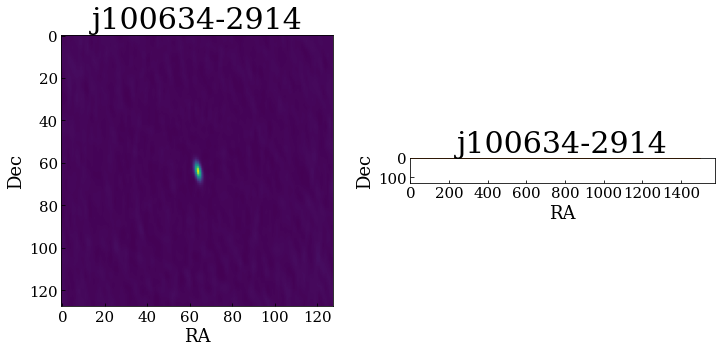

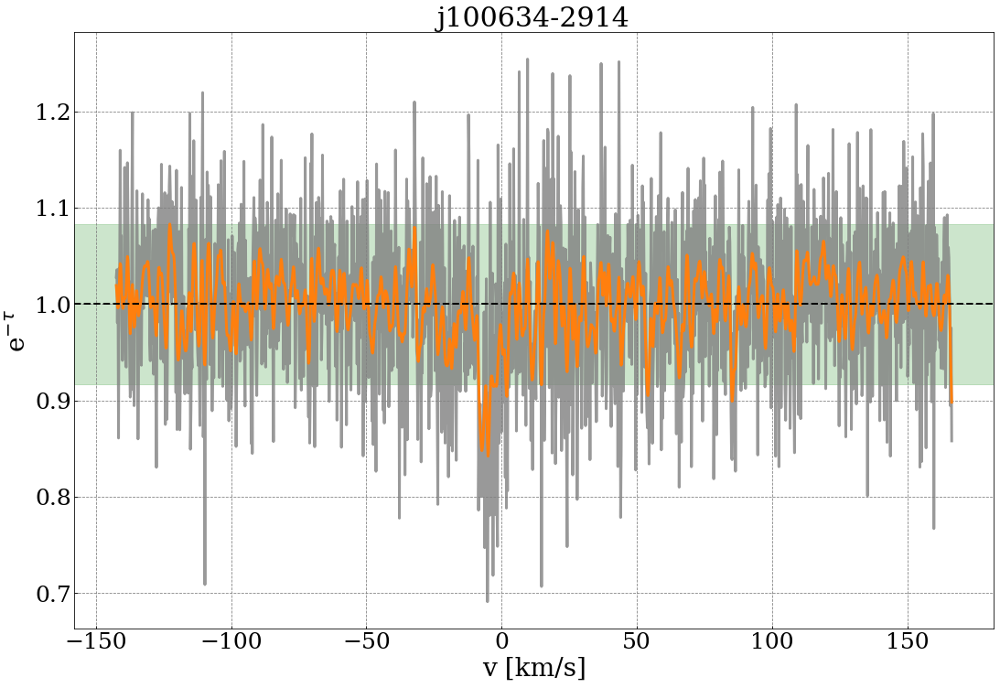

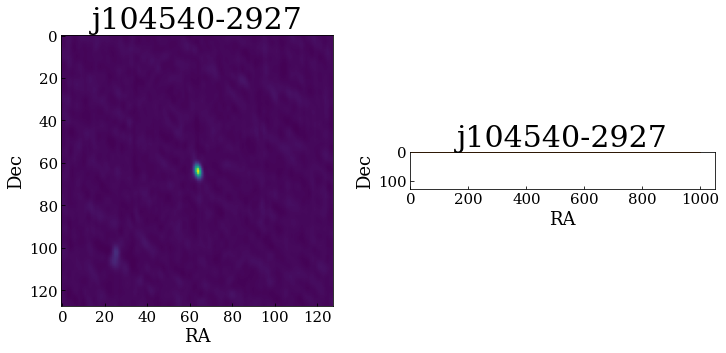

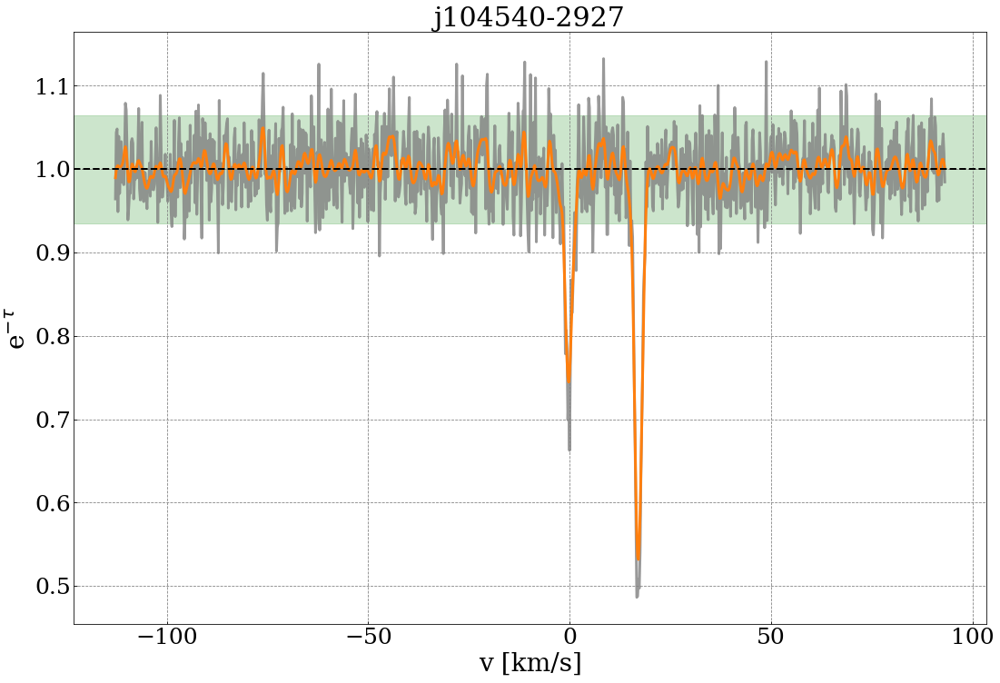

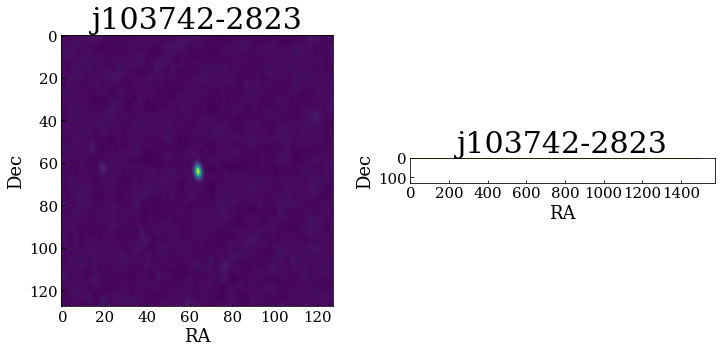

...

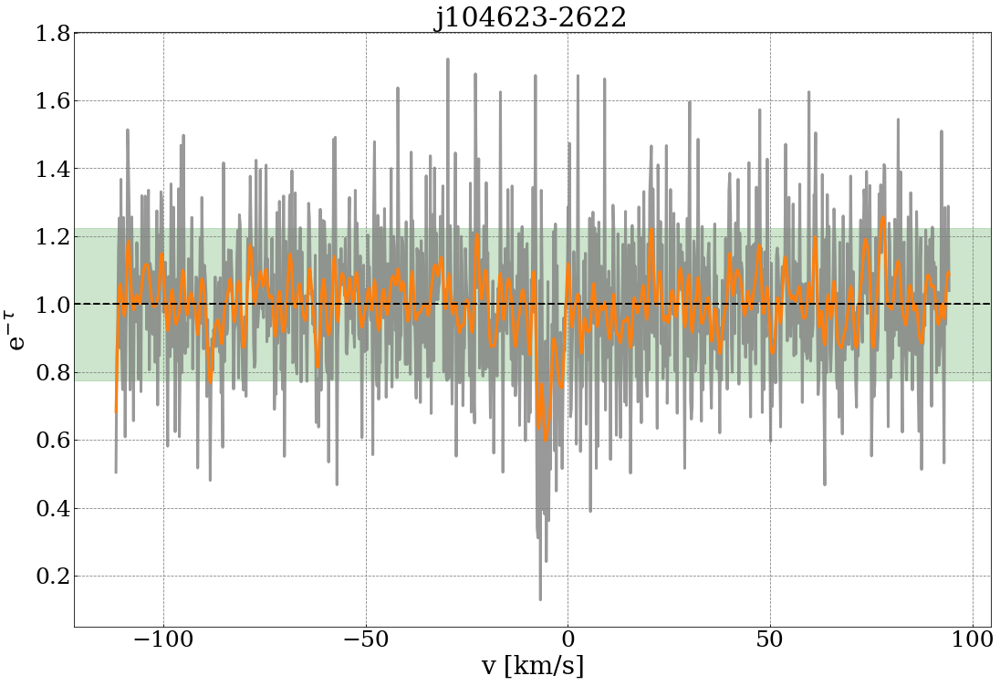

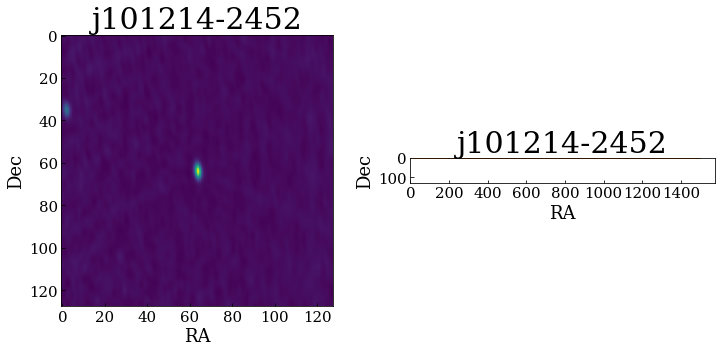

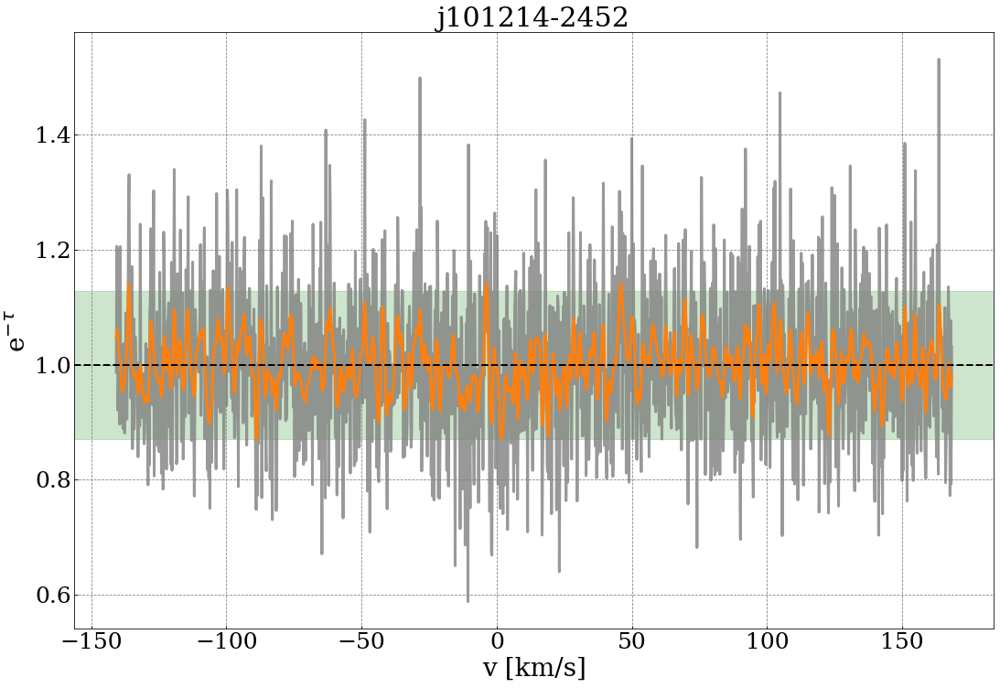

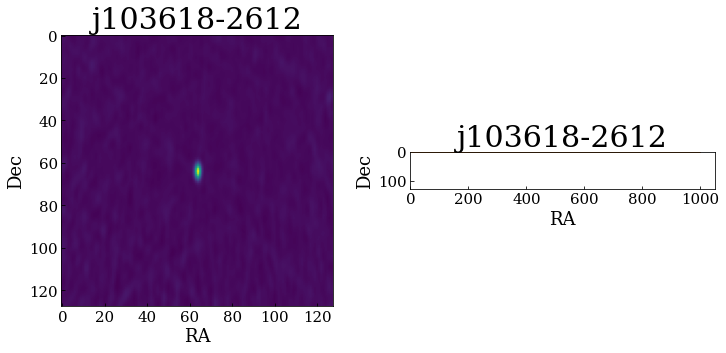

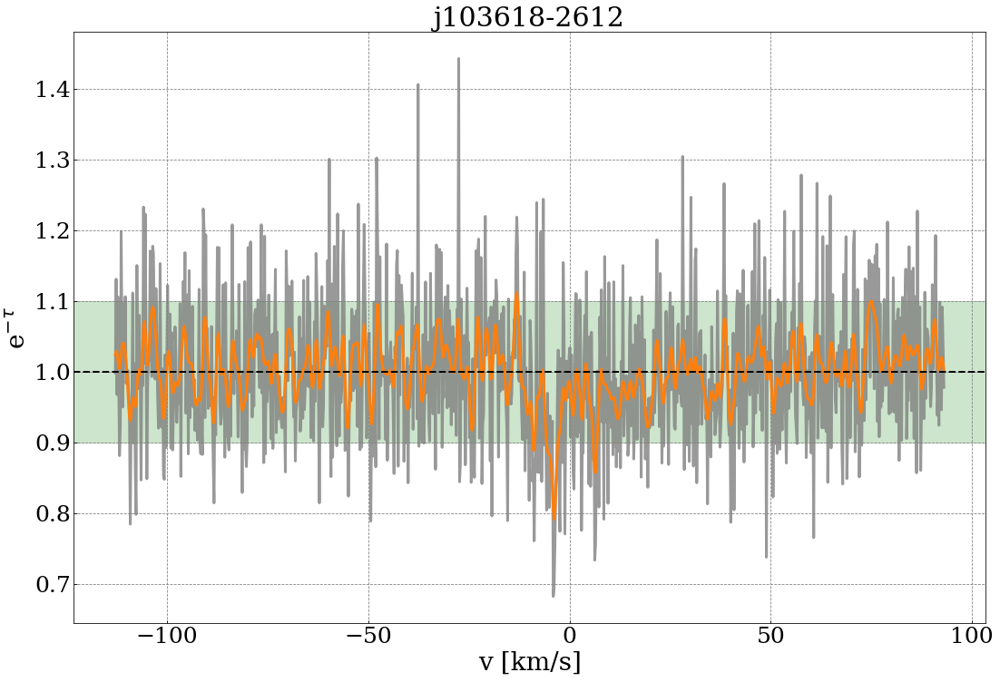

In [7]:
atca_files = os.listdir('/Users/Denes/Research/High_lat_HI/ATCA_data/data_cubes_v2/hydra/')

#for i in atca_files[0:3]:
for i in atca_files:
    plot_spectra_hydra(i)

In [14]:
def plot_spectra_norma(atca_file):
    print(atca_file)
    cube = SpectralCube.read('/Users/Denes/Research/High_lat_HI/ATCA_data/data_cubes_v2/norma/{}'.format(atca_file))  # Open the FITS file for reading
    cube.moment0(axis=0).quicklook()
    
    atca = fits.open('/Users/Denes/Research/High_lat_HI/ATCA_data/data_cubes_v2/norma/{}'.format(atca_file))  # Open the FITS file for reading
    d_atca = atca[0].data
    h_atca = atca[0].header
    w_atca = WCS(h_atca, atca)
    
    d_atca = d_atca[0,:,:,:] # cut polarization axix
    d_atca_av = np.mean(d_atca, axis=0)  # average cube along the velocity axis
    
    # rms and maximum of the image
    print('max image:', np.max(d_atca_av))
    rms = np.sqrt(np.mean(d_atca_av**2))
    print('rms:', rms)
    
    d_atca_av_2 = np.copy(d_atca_av)
    
    d_atca_av_2[d_atca_av_2 < 5*rms] = 'nan'
    
    signal = np.where(d_atca_av_2 > 0)
    print(signal[0])
 
    # plot average data cube image
    fig = plt.figure(figsize=(12,5))
    
    ax = fig.add_subplot(1,2,1)
    plt.title('{}'.format(atca_file[:12]), fontsize=30)
    plt.imshow(d_atca_av)
    ax.set_xlabel('RA', size=18,family='serif')
    ax.set_ylabel('Dec', size=18,family='serif')
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    
    ax = fig.add_subplot(1,2,2)
    plt.title('{}'.format(atca_file[:12]), fontsize=30)
    plt.imshow(d_atca_av_2)
    ax.set_xlabel('RA', size=18,family='serif')
    ax.set_ylabel('Dec', size=18,family='serif')
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)

    fig.savefig('/Users/Denes/Research/High_lat_HI/ATCA_data/maps/{}_map.png'.format(atca_file[:-5]))
    
    c_atca = SkyCoord(ra=h_atca['CRVAL1'], dec=h_atca['CRVAL2'], unit=(u.deg, u.deg))
    pixels_atca = c_atca.to_pixel(w_atca)
    g = Gaussian1DKernel(2.0)
    
    spectrum = cube[:, int(pixels_atca[1]), int(pixels_atca[0])] 
    rms_spect = np.sqrt(np.mean(spectrum**2))
    print('rms spectrum', rms_spect)
    print('max spectrum', np.max(spectrum))

    # replacing the spectral line with the rms to fit the continuum
    spectrum_2 = np.copy(spectrum)
    spectrum_2[spectrum_2 < rms_spect - (np.max(spectrum)-rms_spect) ] = rms_spect

    #plt.plot(spectrum)
    #plt.plot(spectrum_2)

    vel = cube.spectral_axis
    y = spectrum_2
    x = vel.value/1000
    pars = np.polyfit(x, y, 1)
    p = np.poly1d(pars)

    hismooth = convolve(spectrum, g, boundary='extend')
    tauhi_smooth = hismooth/p(vel.value/1000)
    rms_smooth = np.sqrt(np.mean(tauhi_smooth**2))
    tauhi = spectrum/p(vel.value/1000)
    tauhi = np.array(tauhi)
    tau = np.log(tauhi) * -1.
    std_tauhi = np.std(tauhi)

    #tauhi = hismooth/p(hiv)
    minustauhi = 1. - tauhi

    fig = plt.figure(figsize=(18, 12))
    ax = fig.add_subplot(111)
    plt.title('{}'.format(atca_file[:12]), fontsize=30)
    plt.plot(vel/1000, tauhi, linewidth=3, alpha=0.8, color='gray')
    plt.plot(vel/1000, tauhi_smooth, linewidth=3, color='C1')
    ax.axhspan(1-std_tauhi, 1+std_tauhi, alpha=0.2, color='green')

    plt.axhline(1, color='k', linestyle='--', linewidth=2)
    #plt.axvline(0, color='grey', linestyle='--')
    plt.grid(color='grey', linestyle='--')
    #ax.axhspan(1-rms_smooth, 1+rms_smooth, alpha=0.5, color='lightgrey')
    #ax.axvspan(-10, 3, alpha=0.2, color='green')
    plt.ylabel(r'e$^{-\tau}$', fontsize=28)
    plt.xlabel("v [km/s]", fontsize=28)
    #plt.xlim(-40,40)
    ax.tick_params(axis='both', which='major', labelsize=25)
    fig.savefig('/Users/Denes/Research/High_lat_HI/ATCA_data/spectra_plots/{}_spectra.png'.format(atca_file[:-5]))
    
    df_spectra_tauhi = pd.DataFrame()
    df_spectra_tauhi['velocity'] = vel/1000
    df_spectra_tauhi['Amplitude'] = tauhi
    df_spectra_tauhi.to_csv('./spectra/norma/{}_atca_spectrum_tauhi.txt'.format(atca_file[:-5]), sep='\t')
    
    df_spectra = pd.DataFrame()
    df_spectra['velocity'] = vel/1000
    df_spectra['Amplitude'] = spectrum
    df_spectra.to_csv('./spectra/norma/{}_atca_spectrum.txt'.format(atca_file[:-5]), sep='\t')
    


j171029-6041_cube_v2.fits


max image: 1.3977247
rms: 0.02598257
[60 61 61 61 62 62 62 62 63 63 63 63 64 64 64 64 64 65 65 65 65 66 66 66
 66 67 67 67 68]
rms spectrum 0.7913927435874939 Jy / beam
max spectrum 0.9218144416809082 Jy / beam
j163405-5908_cube_v2.fits


max image: 0.0604265
rms: 0.0026009867
[123 123 123 123 123 123 124 124 124 124 124 124 124 125 125 125 125 125
 125 125 125 126 126 126 126 126 126 126 126 127 127 127 127 127 127 127
 127 128 128 128 128 128 128 128 129 129 129 129 129 130 130 130 130]
rms spectrum 0.04038364067673683 Jy / beam
max spectrum 0.11108429729938507 Jy / beam


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


j162909-6133_cube_v2.fits


max image: 0.37152344
rms: 0.008531496
[62 62 63 63 63 63 64 64 64 64 64 65 65 65 65 66]
rms spectrum 0.239055335521698 Jy / beam
max spectrum 0.3328656852245331 Jy / beam
j161257-5737_cube_v2.fits


max image: 0.22499336
rms: 0.007247099
[63 63 63 63 63 64 64 64 64 64 64 64 64 65 65 65 65 65 65 65 65 65 65 66
 66 66 66 66 66 66 66 66 67 67 67 67 67 67 67 67 67 68 68 68 68 68 69 69
 69 69]
rms spectrum 0.0391860231757164 Jy / beam
max spectrum 0.12090235948562622 Jy / beam


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


j155657-7914_cube_v2.fits


max image: 4.8620324
rms: 0.13258088
[56 57 57 58 58 58 59 59 60 60 60 61 61 61 62 62 62 62 63 63 63 64 64 64
 64 65 65 65 66 66 66 67 67 67 68 68 68 69 69 70 70 70 71 71 72]
rms spectrum 4.229196071624756 Jy / beam
max spectrum 4.432061195373535 Jy / beam
j161717-5848_cube_v2.fits


max image: 5.2543945
rms: 0.09613802
[61 61 61 62 62 62 62 63 63 63 63 64 64 64 64 64 65 65 65 65 66 66 66 66
 67 67 67]
rms spectrum 3.2962772846221924 Jy / beam
max spectrum 3.4350907802581787 Jy / beam
j170418-5751_cube_v2.fits


max image: 0.12706976
rms: 0.003880132
[ 3 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66 66 66]
rms spectrum 0.0859600231051445 Jy / beam
max spectrum 0.1398637890815735 Jy / beam


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


j160559-5921_cube_v2.fits


max image: 0.133893
rms: 0.003289535
[29 29 64 64 64 64 65 65 65 65 65 66 66 66 66 66 67 67 67]
rms spectrum 0.04155907407402992 Jy / beam
max spectrum 0.11021551489830017 Jy / beam


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


j160011-5810_cube_v2.fits


max image: 0.6557833
rms: 0.010386754
[62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66 66 66]
rms spectrum 0.4332706928253174 Jy / beam
max spectrum 0.5249344706535339 Jy / beam
j165016-5908_cube_v2.fits


max image: 0.052778058
rms: 0.0015305512
[ 63  63  63  63  64  64  64  64  64  65  65  65  65  66 115 115 116 116]
rms spectrum 0.04691142588853836 Jy / beam
max spectrum 0.08985935151576996 Jy / beam


<ipython-input-14-dd027a58f14c>:80: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(18, 12))


j164939-5956_cube_v2.fits


max image: 0.11633337
rms: 0.0024108544
[62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66 66]
rms spectrum 0.0964718908071518 Jy / beam
max spectrum 0.14691603183746338 Jy / beam
j170706-5802_cube_v2.fits


max image: 0.2973847
rms: 0.0064882827
[62 62 62 63 63 63 63 63 64 64 64 64 64 64 64 65 65 65 65 65 66 66 66]
rms spectrum 0.24526533484458923 Jy / beam
max spectrum 0.32090315222740173 Jy / beam
j163254-5938_cube_v2.fits


max image: 0.071923204
rms: 0.0028951576
[126 126 127 127 127 127 128 128 128 128 128 128 129 129 129 129 129 130
 130 130 130 130 131 131 131 165 165 165 165 165 165 166 166 166 166 166
 166 166 166 166 167 167 167 167 167 167 167 167 167 167 168 168 168 168
 168 168 168 168 168 168 168 169 169 169 169 169 169 169 169 169 169 169
 170 170 170 170 170 170 170 170 170 171 171 171 171 171 171 171 171 172
 172 172 172 172 172]
rms spectrum 0.036796215921640396 Jy / beam
max spectrum 0.10590806603431702 Jy / beam


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


j163157-5935_cube_v2.fits


max image: 0.04451774
rms: 0.004081459
[126 126 126 126 127 127 127 127 127 127 128 128 128 128 128 128 129 129
 129 129 129 129 130 130 130 130]
rms spectrum 0.052758146077394485 Jy / beam
max spectrum 0.13579344749450684 Jy / beam
j163925-6044_cube_v2.fits


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


max image: 0.07667316
rms: 0.002933135
[ 62  63  63  63  64  64  64  64  65  65  65 106 106 106 106 106 107 107
 107 107 107 107 108 108 108 108 108 108 109 109 109]
rms spectrum 0.053453490138053894 Jy / beam
max spectrum 0.11880455166101456 Jy / beam


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


j161749-7717_cube_v2.fits


max image: 3.112558
rms: 0.08708112
[55 56 56 57 57 57 58 58 59 59 59 60 60 60 61 61 61 62 62 62 63 63 63 63
 64 64 64 65 65 65 65 66 66 66 67 67 67 68 68 68 69 69 69 70 70 71 71 71
 72 72 73]
rms spectrum 1.6558467149734497 Jy / beam
max spectrum 1.8093503713607788 Jy / beam
j170336-6212_cube_v2.fits


/opt/anaconda3/lib/python3.8/site-packages/matplotlib/image.py:446: UserWarning: Warning: converting a masked element to nan.
  dv = np.float64(self.norm.vmax) - np.float64(self.norm.vmin)
/opt/anaconda3/lib/python3.8/site-packages/matplotlib/image.py:453: UserWarning: Warning: converting a masked element to nan.
  a_min = np.float64(newmin)
/opt/anaconda3/lib/python3.8/site-packages/matplotlib/image.py:458: UserWarning: Warning: converting a masked element to nan.
  a_max = np.float64(newmax)


max image: 0.29051518
rms: 0.14228903
[]
rms spectrum 0.3473486006259918 Jy / beam
max spectrum 1.5304539203643799 Jy / beam


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


j165842-5948_cube_v2.fits


max image: 0.12444007
rms: 0.002480454
[62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66 66]
rms spectrum 0.10443328320980072 Jy / beam
max spectrum 0.1428855061531067 Jy / beam
j161502-5905_cube_v2.fits


max image: 0.15201391
rms: 0.016082771
[ 41  41  41  42  42  42  43  43  64  64  65  65  65  66  66 109 109 109
 110 110 110 110 111 111 112 113 121 122 122 123 123 123 124 124 125 126
 127 127]
rms spectrum 0.06237678974866867 Jy / beam
max spectrum 0.14949378371238708 Jy / beam


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


j165824-6116_cube_v2.fits


max image: 0.18471248
rms: 0.006029263
[31 31 31 32 32 32 32 33 33 33 33 34 34 34 34 35 35 35 35 36 36 36 37 37
 58 58 58 59 59 59 59 60 60 60 60 60 61 61 61 61 61 61 62 62 62 62 62 62
 62 63 63 63 63 63 63 63 64 64 64 64 64 64 64 65 65 65 65 65 65 65 66 66
 66 66 66 67 67 67 67 68 68]
rms spectrum 0.06948249042034149 Jy / beam
max spectrum 0.16228888928890228 Jy / beam


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


j161853-5910_cube_v2.fits


max image: 0.33329213
rms: 0.019464381
[  2   2   3   3  38  38  39  39  40  58  58  59  59  59  60  60  60  60
  61  61  61  61  61  62  62  62  62  63  63  63  63  63  63  64  64  64
  64  65  65  65  66  66  67  75  76  76  77  77 109 110 112 113 114 114
 115 117 118 118 119 119 120 120 121 121 122 125 126 126 127]
rms spectrum 0.26845207810401917 Jy / beam
max spectrum 0.40087637305259705 Jy / beam
j165449-6013_cube_v2.fits


max image: 0.0729053
rms: 0.0038006576
[61 61 62 62 63 63 63 63 64 64 64 64 65 65 65 65 66 66 66 67 67 67 68 68
 74 75]
rms spectrum 0.03951163589954376 Jy / beam
max spectrum 0.10070118308067322 Jy / beam


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


j164039-6004_cube_v2.fits


max image: 0.048113912
rms: 0.0026775815
[125 125 125 126 126 126 126 126 126 127 127 127 127 127 127 127 128 128
 128 128 128 128 128 129 129 129 129 129 129 129 130 130 130 130 130 131
 131 131 131]
rms spectrum 0.05030285194516182 Jy / beam
max spectrum 0.11151000112295151 Jy / beam


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


j162700-6043_cube_v2.fits


max image: 0.075659096
rms: 0.0025992354
[63 63 63 64 64 64 64 64 65 65 65 65 66 93 93 94 94 94 94 95 95 95]
rms spectrum 0.05471470206975937 Jy / beam
max spectrum 0.14546510577201843 Jy / beam


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


j170433-5914_cube_v2.fits


max image: 0.13906522
rms: 0.0024555062
[62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66 66]
rms spectrum 0.10608618706464767 Jy / beam
max spectrum 0.1435740888118744 Jy / beam
j161051-5750_cube_v2.fits


max image: 0.08735907
rms: 0.0037056638
[ 64  64  64  65  65  65  65  66  66  66  66  67  67  67 118]
rms spectrum 0.02576673962175846 Jy / beam
max spectrum 0.09081082046031952 Jy / beam


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


j154606-7310_cube_v2.fits


max image: 0.6423221
rms: 0.02838277
[56 56 57 57 57 57 58 58 58 58 59 59 59 59 59 59 60 60 60 60 60 61 61 61
 61 61 61 62 62 62 62 62 62 63 63 63 63 63 63 64 64 64 64 64 64 65 65 65
 65 65 65 66 66 66 66 66 66 67 67 67 67 67 67 68 68 68 68 68 68 69 69 69
 69 69 70 70 70 70 70 70 71 71 71 71 72 72 72 73]
rms spectrum 0.2914547920227051 Jy / beam
max spectrum 0.4721568524837494 Jy / beam
j165201-5817_cube_v2.fits


max image: 0.22461276
rms: 0.004169743
[62 62 63 63 63 63 64 64 64 64 64 65 65 65 65 66 66 66]
rms spectrum 0.14195922017097473 Jy / beam
max spectrum 0.21974211931228638 Jy / beam
j162854-6151_cube_v2.fits


max image: 0.7969142
rms: 0.012131621
[62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66 66 66]
rms spectrum 0.5109360218048096 Jy / beam
max spectrum 0.604476809501648 Jy / beam
j165636-6055_cube_v2.fits


max image: 0.26305488
rms: 0.0069412226
[61 61 61 61 61 62 62 62 62 62 62 62 63 63 63 63 63 63 63 64 64 64 64 64
 64 64 65 65 65 65 65 65 65 66 66 66 66 66 66 67 67 67 68 68]
rms spectrum 0.11022766679525375 Jy / beam
max spectrum 0.22045335173606873 Jy / beam
j162150-6045_cube_v2.fits


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


max image: 0.10922694
rms: 0.002714225
[62 62 63 63 63 63 64 64 64 64 64 65 65 65 65 66 66]
rms spectrum 0.06962306797504425 Jy / beam
max spectrum 0.1428869217634201 Jy / beam


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


j162332-5829_cube_v2.fits


max image: 0.15365031
rms: 0.005984263
[ 60  60  61  61  61  62  62  62  63  63  63  63  64  64  64  64  65  65
  65  65  66  66 124 127]
rms spectrum 0.02846880815923214 Jy / beam
max spectrum 0.07563399523496628 Jy / beam


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


j165440-5801_cube_v2.fits


max image: 0.08434521
rms: 0.0026265031
[62 62 63 63 63 64 64 64 64 65 65 65 65 66 66]
rms spectrum 0.05571790039539337 Jy / beam
max spectrum 0.12176038324832916 Jy / beam


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


j170242-5803_cube_v2.fits


max image: 0.2183046
rms: 0.0040365374
[62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66 66 66]
rms spectrum 0.1441793292760849 Jy / beam
max spectrum 0.21943329274654388 Jy / beam


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


j161834-5809_cube_v2.fits


max image: 0.14001736
rms: 0.004640188
[61 62 62 62 62 63 63 63 64 64 64 64 65 65 65 65 65 66 66 66 66 67 67 67]
rms spectrum 0.06016718968749046 Jy / beam
max spectrum 0.13605356216430664 Jy / beam


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


j164153-5951_cube_v2.fits


max image: 0.04032584
rms: 0.0037889313
[ 11  11  12  12  13  13  14  15  16  34  34  35  35  36  36  37  37  37
  38  38  38  38  39  39  39  39  40  40  40 109 109 110 110 110 111 111
 125 125 125 125 126 126 126 126 126 127 127 127 127 127 127 128 128 128
 128 128 128 129 129 129 129 129 129 130 130 130 130 131 238 239 239 240
 240]
rms spectrum 0.04325428232550621 Jy / beam
max spectrum 0.1316237449645996 Jy / beam


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


j165657-6023_cube_v2.fits


max image: 0.12144331
rms: 0.004172492
[61 61 61 62 62 62 62 63 63 63 63 63 63 64 64 64 64 64 64 65 65 65 65 65
 65 65 66 66 66 66 66 66 67 67 67 67 67 67 68]
rms spectrum 0.12606151401996613 Jy / beam
max spectrum 0.22048872709274292 Jy / beam


<ipython-input-14-dd027a58f14c>:74: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


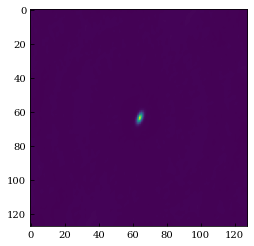

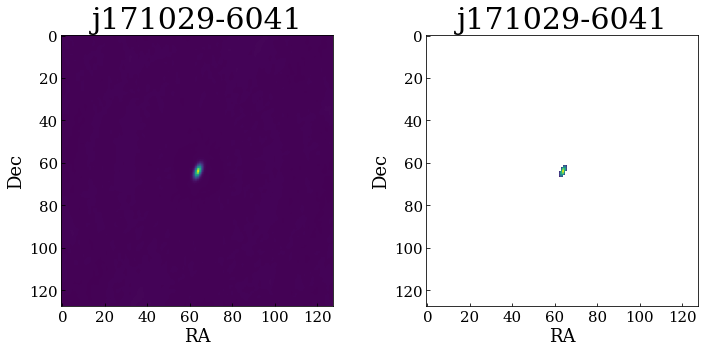

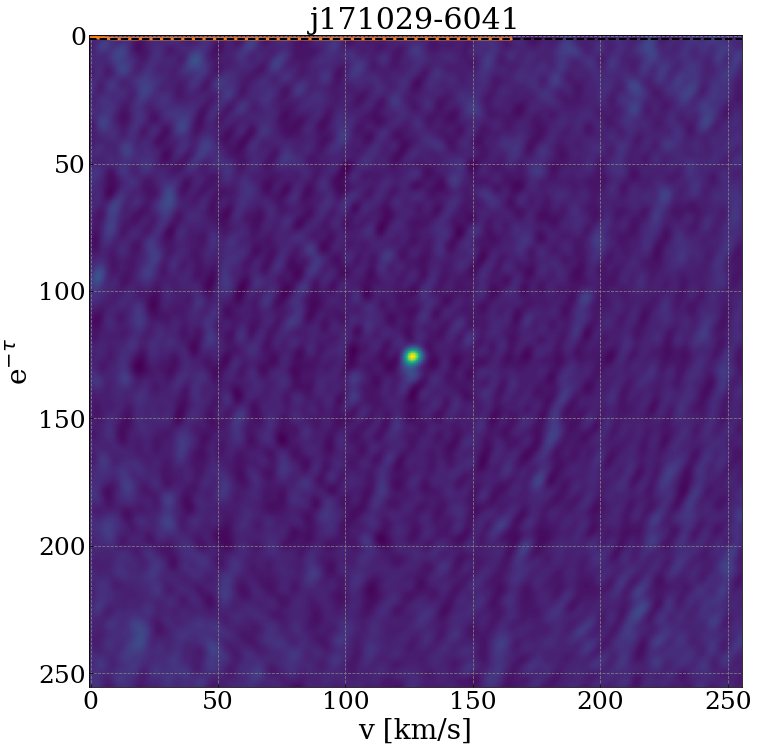

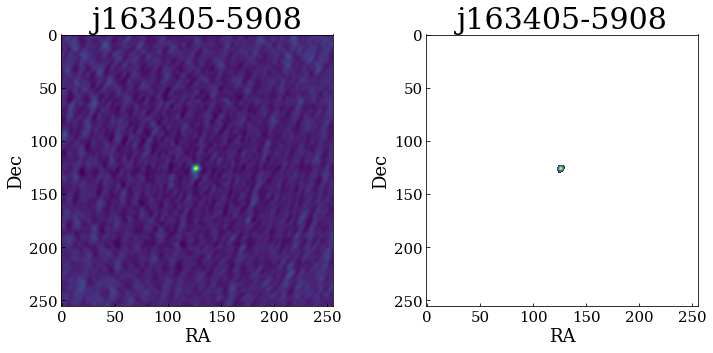

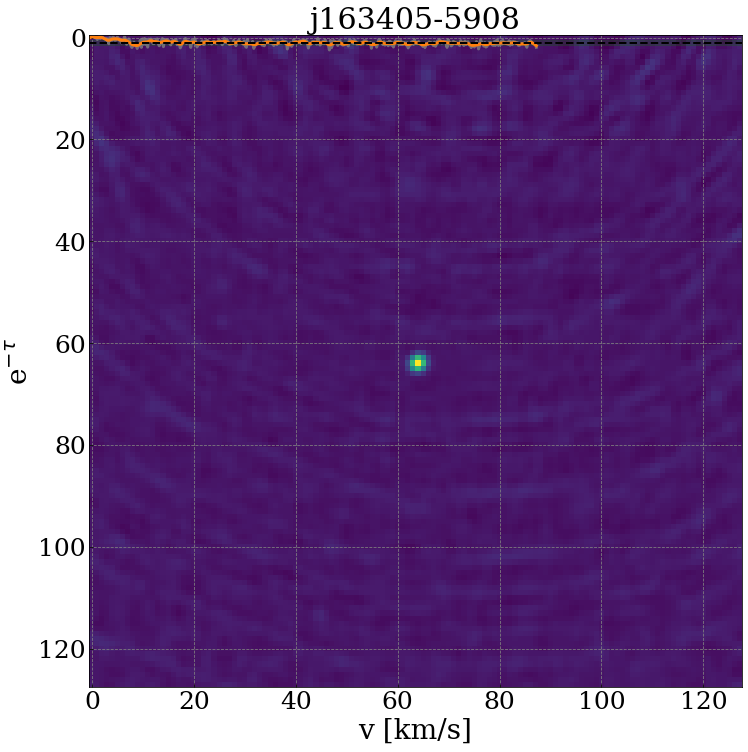

...

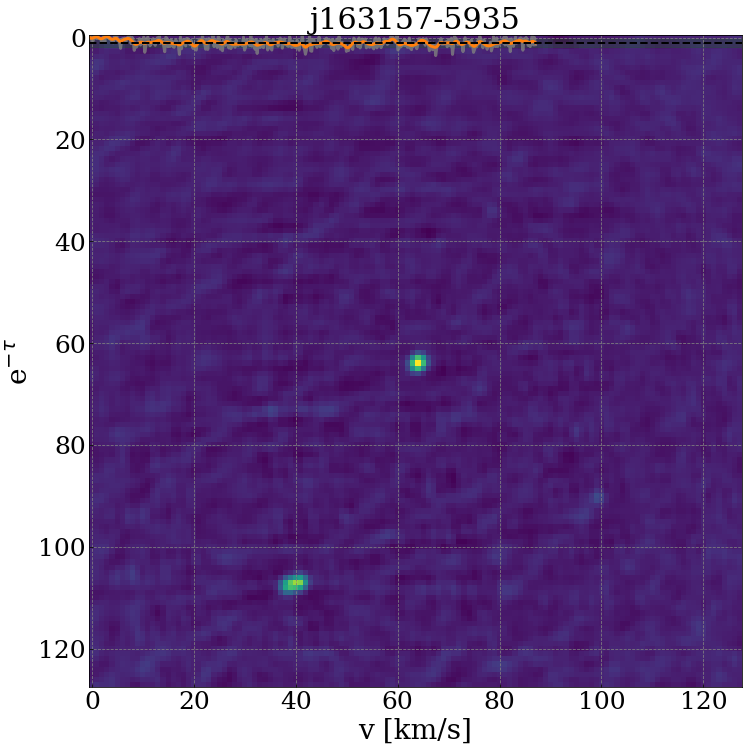

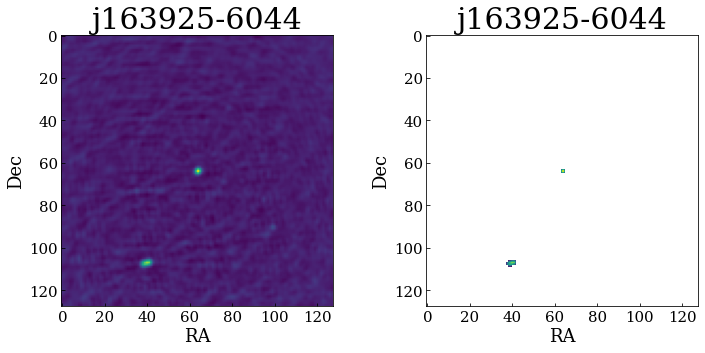

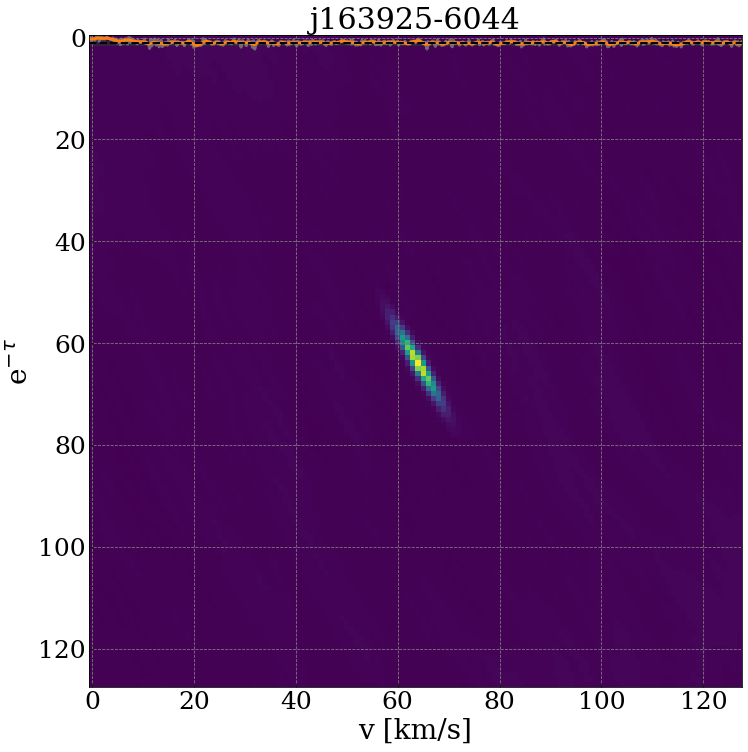

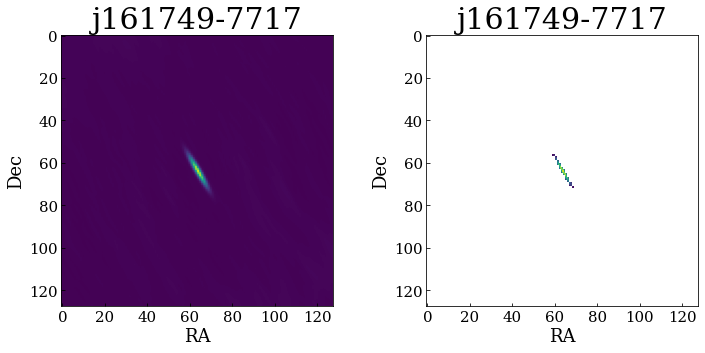

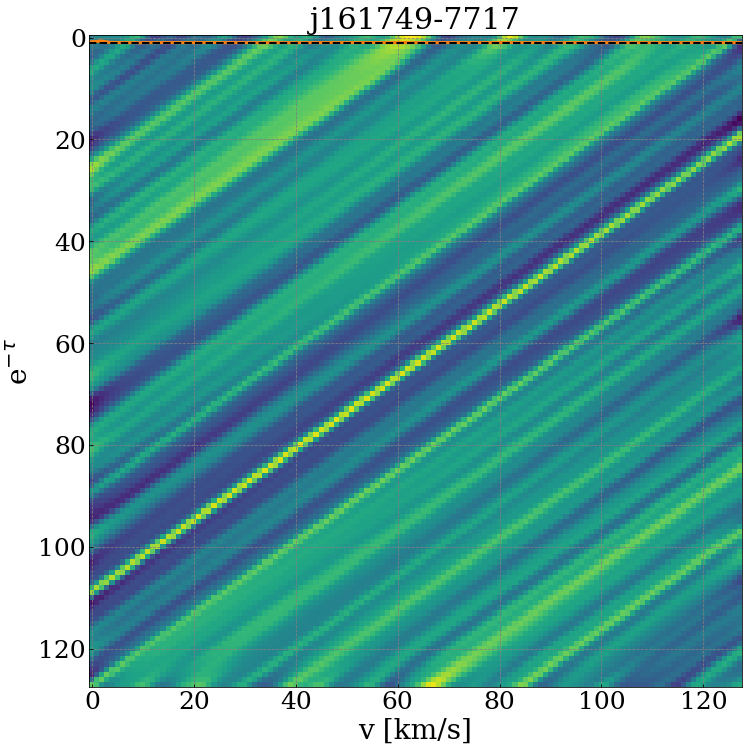

/opt/anaconda3/lib/python3.8/site-packages/matplotlib/image.py:446: UserWarning: Warning: converting a masked element to nan.
  dv = np.float64(self.norm.vmax) - np.float64(self.norm.vmin)
/opt/anaconda3/lib/python3.8/site-packages/matplotlib/image.py:453: UserWarning: Warning: converting a masked element to nan.
  a_min = np.float64(newmin)
/opt/anaconda3/lib/python3.8/site-packages/matplotlib/image.py:458: UserWarning: Warning: converting a masked element to nan.
  a_max = np.float64(newmax)


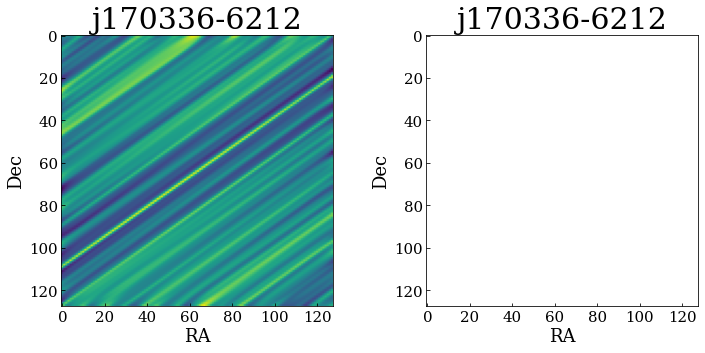

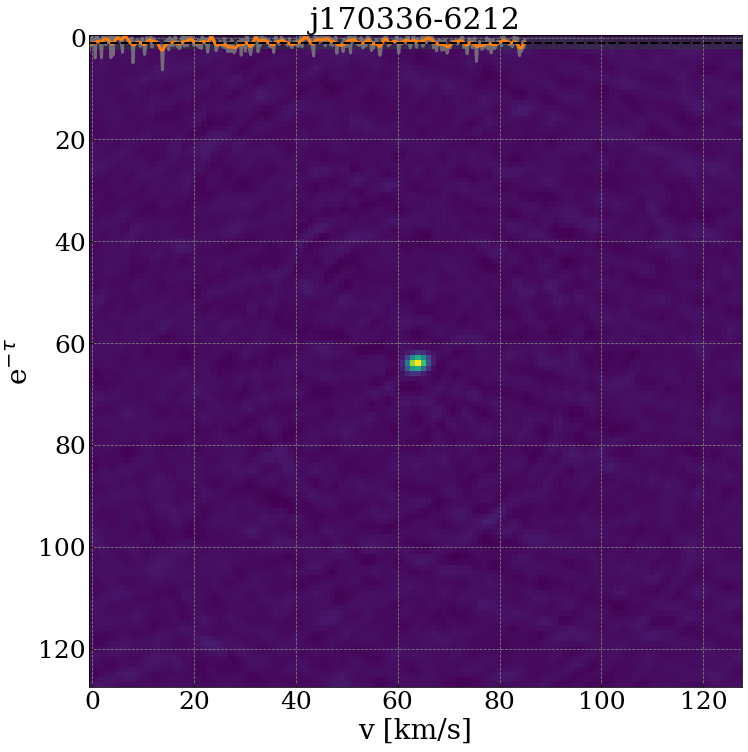

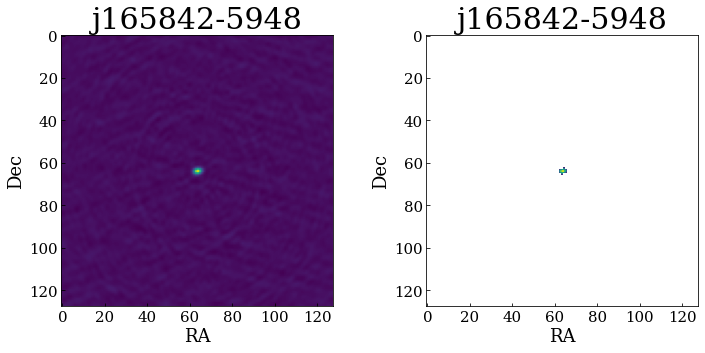

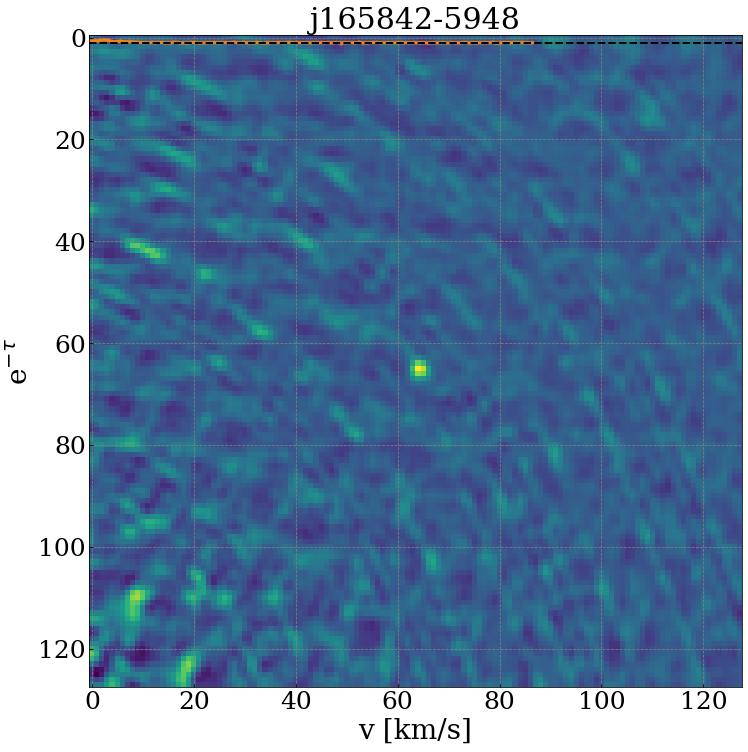

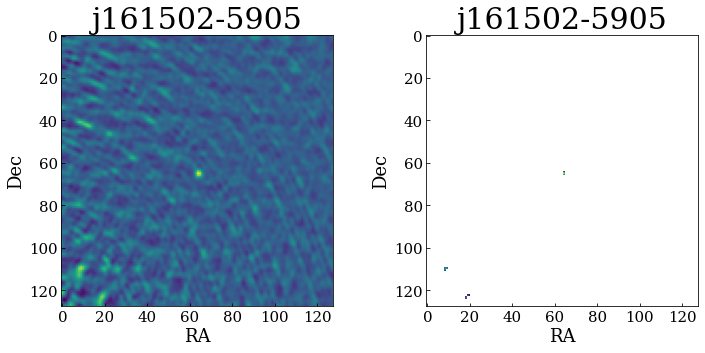

...

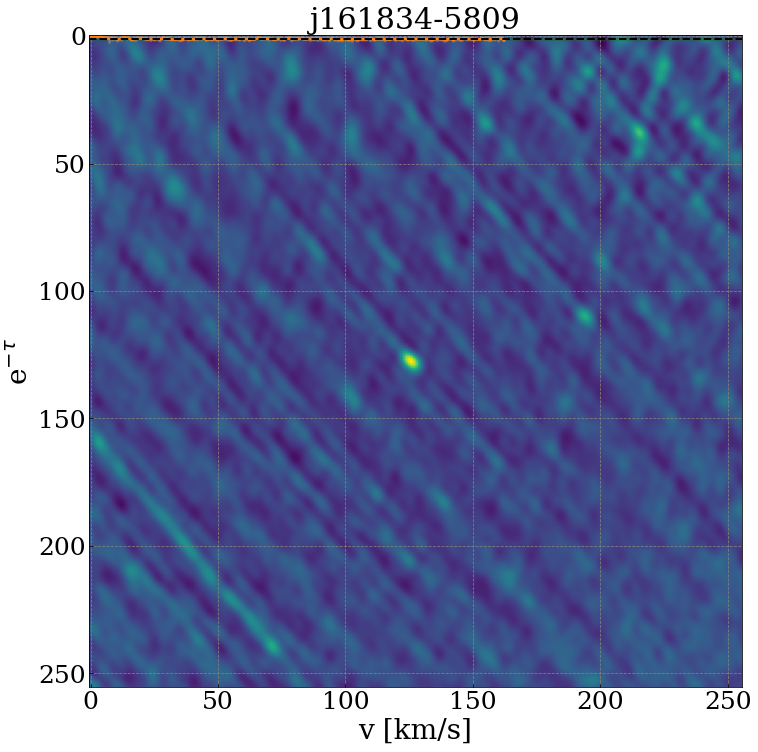

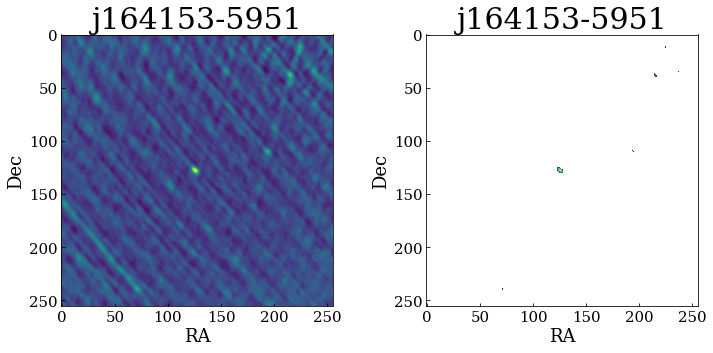

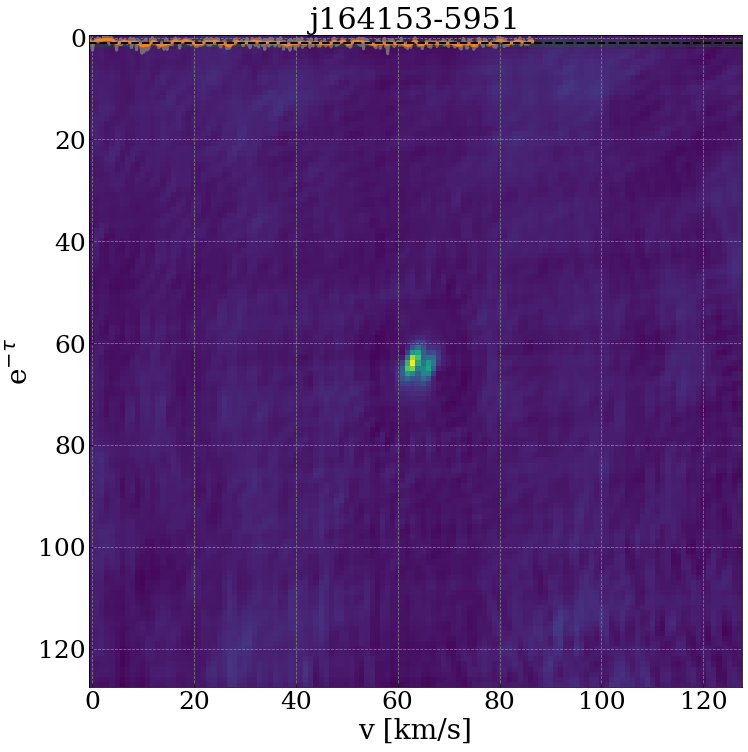

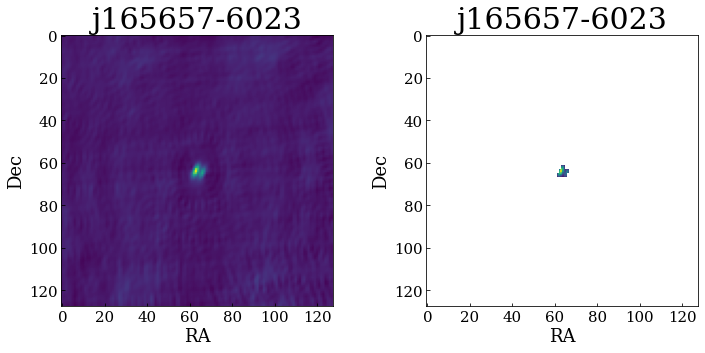

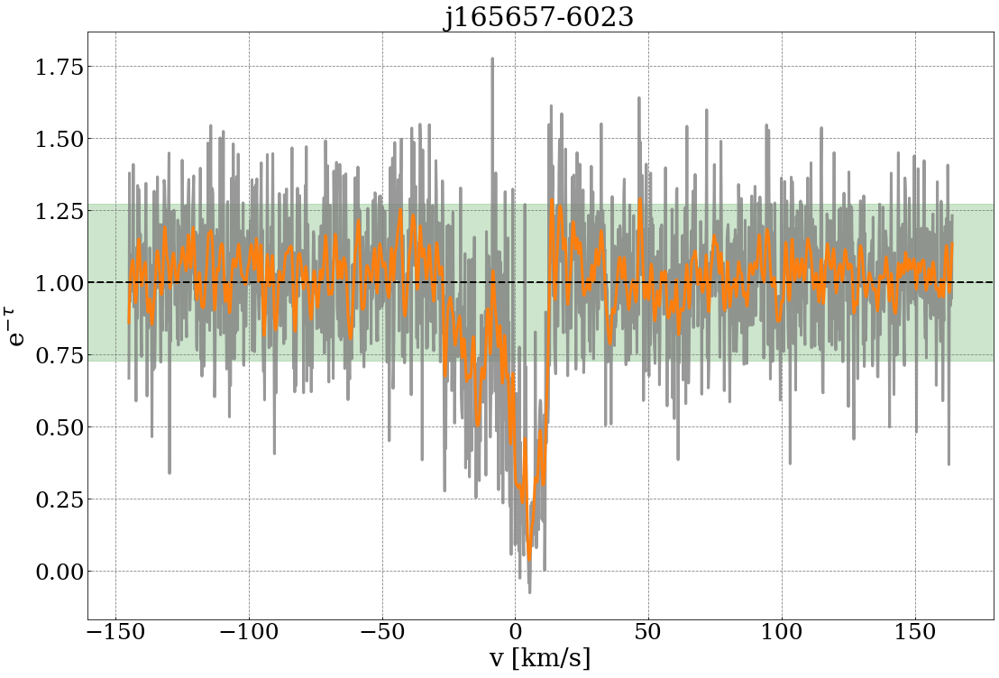

In [15]:
atca_files = os.listdir('/Users/Denes/Research/High_lat_HI/ATCA_data/data_cubes_v2/norma')

for i in atca_files:
    try:
        plot_spectra_norma(i)
    except Exception as e:
        print(e)
        continue
    

# Plot file names for latex document

In [9]:
atca_files.sort()

for i in range(len(atca_files)):
    print('\subfigure{\includegraphics[width=8.5cm]{spectra/'+atca_files[i][:12]+'_cube_v2_spectra.png}}')

\subfigure{\includegraphics[width=8.5cm]{spectra/.DS_Store_cube_v2_spectra.png}}
\subfigure{\includegraphics[width=8.5cm]{spectra/j154606-7310_cube_v2_spectra.png}}
\subfigure{\includegraphics[width=8.5cm]{spectra/j155657-7914_cube_v2_spectra.png}}
\subfigure{\includegraphics[width=8.5cm]{spectra/j160011-5810_cube_v2_spectra.png}}
\subfigure{\includegraphics[width=8.5cm]{spectra/j160559-5921_cube_v2_spectra.png}}
\subfigure{\includegraphics[width=8.5cm]{spectra/j161051-5750_cube_v2_spectra.png}}
\subfigure{\includegraphics[width=8.5cm]{spectra/j161257-5737_cube_v2_spectra.png}}
\subfigure{\includegraphics[width=8.5cm]{spectra/j161502-5905_cube_v2_spectra.png}}
\subfigure{\includegraphics[width=8.5cm]{spectra/j161717-5848_cube_v2_spectra.png}}
\subfigure{\includegraphics[width=8.5cm]{spectra/j161749-7717_cube_v2_spectra.png}}
\subfigure{\includegraphics[width=8.5cm]{spectra/j161834-5809_cube_v2_spectra.png}}
\subfigure{\includegraphics[width=8.5cm]{spectra/j161853-5910_cube_v2_spectra.p

In [ ]:
atca_files = os.listdir('/Users/Denes/Research/High_lat_HI/data_cubes_v2/hydra/')

for i in range(len(atca_files)):
    print('\subfigure{\includegraphics[width=8.5cm]{spectra_both/spectra_'+atca_files[i][1:12]+'_ASKAP_ATCA.png}}')



## Plots with 4k data cubes

In [10]:
def plot_spectra_hydra_4k(atca_file):
    cube = SpectralCube.read('/Users/Denes/Research/High_lat_HI/ATCA_data/data_cubes_4k/hydra/{}'.format(atca_file))  # Open the FITS file for reading
    
    atca = fits.open('/Users/Denes/Research/High_lat_HI/ATCA_data/data_cubes_4k/hydra/{}'.format(atca_file))  # Open the FITS file for reading
    d_atca = atca[0].data
    h_atca = atca[0].header
    w_atca = WCS(h_atca, atca)
    
    d_atca = d_atca[0,:,:,:] # cut polarization axix
    d_atca_av = np.mean(d_atca, axis=0)  # average cube along the velocity axis
    
    # rms and maximum of the image
    print('max image:', np.max(d_atca_av))
    rms = np.sqrt(np.mean(d_atca_av**2))
    print('rms:', rms)
    
    d_atca_av_2 = np.copy(d_atca_av)
    
    d_atca_av_2[d_atca_av_2 < 5*rms] = 'nan'
    
    signal = np.where(d_atca_av_2 > 0)
    print(signal[0])
 
    # plot average data cube image
    fig = plt.figure(figsize=(12,5))
    
    ax = fig.add_subplot(1,2,1)
    plt.title('{}'.format(atca_file[:12]), fontsize=30)
    plt.imshow(d_atca_av)
    ax.set_xlabel('RA', size=18,family='serif')
    ax.set_ylabel('Dec', size=18,family='serif')
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    
    ax = fig.add_subplot(1,2,2)
    plt.title('{}'.format(atca_file[:12]), fontsize=30)
    plt.imshow(d_atca_av_2)
    ax.set_xlabel('RA', size=18,family='serif')
    ax.set_ylabel('Dec', size=18,family='serif')
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)

    fig.savefig('/Users/Denes/Research/High_lat_HI/ATCA_data/maps/{}_4k_map.png'.format(atca_file[:-5]))
    
    c_atca = SkyCoord(ra=h_atca['CRVAL1'], dec=h_atca['CRVAL2'], unit=(u.deg, u.deg))
    pixels_atca = c_atca.to_pixel(w_atca)
    g = Gaussian1DKernel(2.0)
    
    spectrum = cube[:, int(pixels_atca[1]), int(pixels_atca[0])] 
    rms_spect = np.sqrt(np.mean(spectrum**2))
    print('rms spectrum', rms_spect)
    print('max spectrum', np.max(spectrum))

    # replacing the spectral line with the rms to fit the continuum
    spectrum_2 = np.copy(spectrum)
    spectrum_2[spectrum_2 < rms_spect - (np.max(spectrum)-rms_spect) ] = rms_spect

    plt.plot(spectrum)
    plt.plot(spectrum_2)

    vel = cube.spectral_axis
    y = spectrum_2
    x = vel.value/1000
    pars = np.polyfit(x, y, 1)
    p = np.poly1d(pars)

    hismooth = convolve(spectrum, g, boundary='extend')
    tauhi_smooth = hismooth/p(vel.value/1000)
    rms_smooth = np.sqrt(np.mean(tauhi_smooth**2))
    tauhi = spectrum/p(vel.value/1000)
    tauhi = np.array(tauhi)
    tau = np.log(tauhi) * -1.
    std_tauhi = np.std(tauhi)

    #tauhi = hismooth/p(hiv)
    minustauhi = 1. - tauhi

    fig = plt.figure(figsize=(18, 12))
    ax = fig.add_subplot(111)
    plt.title('{}'.format(atca_file[:12]), fontsize=30)
    plt.plot(vel/1000, tauhi, linewidth=3, alpha=0.8, color='gray')
    plt.plot(vel/1000, tauhi_smooth, linewidth=3, color='C1')
    ax.axhspan(1-std_tauhi, 1+std_tauhi, alpha=0.2, color='green')

    plt.axhline(1, color='k', linestyle='--', linewidth=2)
    #plt.axvline(0, color='grey', linestyle='--')
    plt.grid(color='grey', linestyle='--')
    #ax.axhspan(1-rms_smooth, 1+rms_smooth, alpha=0.5, color='lightgrey')
    #ax.axvspan(-10, 3, alpha=0.2, color='green')
    plt.ylabel(r'e$^{-\tau}$', fontsize=28)
    plt.xlabel("v [km/s]", fontsize=28)
    #plt.xlim(-40,40)
    ax.tick_params(axis='both', which='major', labelsize=25)
    fig.savefig('/Users/Denes/Research/High_lat_HI/ATCA_data/spectra_plots/{}_4k_spectra.png'.format(atca_file[:-5]))
    
    df_spectra_tauhi = pd.DataFrame()
    df_spectra_tauhi['velocity'] = vel/1000
    df_spectra_tauhi['Amplitude'] = tauhi
    df_spectra_tauhi.to_csv('./spectra/hydra/{}_atca_4k_spectrum_tauhi.txt'.format(atca_file[:-5]), sep='\t')
    
    df_spectra = pd.DataFrame()
    df_spectra['velocity'] = vel/1000
    df_spectra['Amplitude'] = spectrum
    df_spectra.to_csv('./spectra/hydra/{}_atca_4k_spectrum.txt'.format(atca_file[:-5]), sep='\t')


max image: 0.16006605
rms: 0.004710917
[ 37  37  38  38  39  39  40  40  41  59  60  60  60  61  61  61  61  62
  62  62  62  63  63  63  63  63  64  64  64  64  64  65  65  65  65  65
  66  66  66  66  67  67  67  67  68  68  68 124 124 125 125 126 126 126
 127 127 127]
rms spectrum 0.12494885921478271 Jy / beam
max spectrum 0.13949595391750336 Jy / beam


max image: 0.24811251
rms: 0.0069436966
[32 32 32 33 33 33 34 34 34 35 35 35 36 36 36 36 37 37 37 38 38 39 39 59
 59 60 60 60 61 61 61 61 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65
 65 65 65 66 66 66 66 67 67 67 67 68 68 68 69 69]
rms spectrum 0.16771607100963593 Jy / beam
max spectrum 0.1779211312532425 Jy / beam


max image: 0.076342106
rms: 0.009051722
[ 0  4  5  6  8  9 10 16 17 17 18 18 18 19 19 20 20 21 22 25 28 28 29 29
 29 29 30 30 30 30 30 30 31 31 31 31 31 31 32 32 32 32 63 63 64 64 65 65
 66]
rms spectrum 0.046363040804862976 Jy / beam
max spectrum 0.05276936665177345 Jy / beam


max image: 0.5585534
rms: 0.014348
[59 60 60 60 61 61 61 62 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65
 65 65 65 66 66 66 66 66 67 67 67 68 68 68 69 69 69]
rms spectrum 0.35581767559051514 Jy / beam
max spectrum 0.3761462867259979 Jy / beam


max image: 0.42974585
rms: 0.009981368
[60 60 61 61 61 61 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65
 65 66 66 66 66 67 67 67 67 68 68]
rms spectrum 0.2921881377696991 Jy / beam
max spectrum 0.3067954182624817 Jy / beam


max image: 0.80327654
rms: 0.025048014
[55 56 56 57 57 58 58 58 59 59 59 60 60 60 61 61 61 61 62 62 62 62 63 63
 63 63 64 64 64 65 65 65 65 66 66 66 66 67 67 67 67 68 68 68 69 69 69 70
 70 70 71 71 72 72 73]
rms spectrum 0.5931329131126404 Jy / beam
max spectrum 0.6142810583114624 Jy / beam


max image: 0.31322607
rms: 0.0093262
[60 60 60 60 61 61 61 61 62 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65
 65 65 65 65 66 66 66 66 66 67 67 67 67 68 68 68 68 69 69 82 82 83 83 83
 84 84 84 84 85 85 85 85 86 86 86 86 87 87 88 88]
rms spectrum 0.23502260446548462 Jy / beam
max spectrum 0.24911367893218994 Jy / beam


max image: 0.7788719
rms: 0.024625149
[55 56 56 57 57 58 58 58 59 59 59 60 60 60 60 61 61 61 61 62 62 62 62 63
 63 63 63 64 64 64 64 65 65 65 65 66 66 66 66 67 67 67 67 68 68 68 69 69
 69 70 70 70 71 71 72 72 73]
rms spectrum 0.5391317009925842 Jy / beam
max spectrum 0.5572017431259155 Jy / beam


max image: 0.095321596
rms: 0.0025339904
[50 50 51 51 52 52 52 53 53 53 54 54 54 55 55 56 56 59 59 60 60 60 61 61
 61 62 62 62 62 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66 66 66 66 67
 67 67 67 68 68 68 69 69 69]
rms spectrum 0.0715860053896904 Jy / beam
max spectrum 0.0778283104300499 Jy / beam


max image: 0.19888076
rms: 0.006123037
[ 4 60 60 61 61 61 61 62 62 62 62 62 63 63 63 63 63 64 64 64 64 64 64 64
 65 65 65 65 65 65 65 65 66 66 66 66 66 66 66 66 67 67 67 67 67 67 67 68
 68 68 68 68 68 69 69 70 70 94 95 95 95 96 96 96 97 97]
rms spectrum 0.14159727096557617 Jy / beam
max spectrum 0.15556935966014862 Jy / beam


<ipython-input-10-ea724496e6a6>:25: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(12,5))


max image: 0.38543063
rms: 0.011892948
[28 28 29 29 29 30 30 30 30 31 31 31 31 32 32 32 32 33 33 33 34 34 60 60
 60 61 61 61 62 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65
 66 66 66 66 66 67 67 67 68 68 68]
rms spectrum 0.2567998468875885 Jy / beam
max spectrum 0.27404364943504333 Jy / beam


max image: 0.37416297
rms: 0.0118656065
[59 59 60 60 60 61 61 61 61 62 62 62 62 63 63 63 63 64 64 64 64 65 65 65
 65 66 66 66 66 67 67 67 67 68 68 68 68 69 69 70 70]
rms spectrum 0.2992017865180969 Jy / beam
max spectrum 0.3136005401611328 Jy / beam


max image: 0.18739028
rms: 0.008500723
[54 55 55 56 56 56 57 57 58 58 59 59 59 60 60 60 61 61 61 62 62 62 63 63
 63 64 64 64 64 65 65 65 65 66 66 66 67 67 67 68 68 68 69 69 69 70 70 71
 71 72 72 73]
rms spectrum 0.08066372573375702 Jy / beam
max spectrum 0.09349404275417328 Jy / beam


max image: 0.68905467
rms: 0.02431328
[62 62 62 62 62 62 63 63 63 63 63 63 63 63 64 64 64 64 64 64 64 64 64 64
 65 65 65 65 65 65 65 65 65 65 66 66 66 66 66 66 66 66 66 66 67 67 67 67
 67 67 67 67]
rms spectrum 0.47071826457977295 Jy / beam
max spectrum 0.49118760228157043 Jy / beam


max image: 0.9752505
rms: 0.02275359
[60 60 61 61 61 61 62 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65
 65 65 66 66 66 66 66 67 67 67 67 68 68]
rms spectrum 0.6697704792022705 Jy / beam
max spectrum 0.6836637258529663 Jy / beam


max image: 0.32327476
rms: 0.009147374
[59 59 60 60 60 61 61 61 61 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65
 65 65 65 66 66 66 66 67 67 67 68 68 68 69 69]
rms spectrum 0.2450631856918335 Jy / beam
max spectrum 0.26363909244537354 Jy / beam


max image: 0.20247929
rms: 0.0052839
[33 33 34 34 34 35 35 35 36 36 37 37 38 38 59 59 60 60 60 61 61 61 61 62
 62 62 62 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66 66 66 66 67 67 67
 67 68 68 68 69 69 69 70]
rms spectrum 0.15690071880817413 Jy / beam
max spectrum 0.1652544140815735 Jy / beam


max image: 0.40693724
rms: 0.009812101
[60 60 61 61 61 61 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65
 65 66 66 66 66 66 67 67 67 67 68 68 68]
rms spectrum 0.28708168864250183 Jy / beam
max spectrum 0.30269676446914673 Jy / beam


max image: 0.69703454
rms: 0.017008727
[60 60 60 61 61 61 61 62 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65
 65 65 65 66 66 66 66 66 67 67 67 67 67 68 68 68]
rms spectrum 0.4816303849220276 Jy / beam
max spectrum 0.5004631876945496 Jy / beam


max image: 0.20018426
rms: 0.008647204
[54 55 55 56 56 56 57 57 57 58 58 58 59 59 60 60 60 61 61 61 62 62 62 63
 63 63 64 64 64 65 65 65 65 66 66 66 67 67 67 68 68 68 69 69 69 70 70 70
 71 71 72 72 73 73]
rms spectrum 0.09853898733854294 Jy / beam
max spectrum 0.11461811512708664 Jy / beam


max image: 0.6691558
rms: 0.01652669
[60 60 61 61 61 61 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65
 65 66 66 66 66 66 67 67 67 67 68 68 68]
rms spectrum 0.45748090744018555 Jy / beam
max spectrum 0.4733356237411499 Jy / beam


max image: 0.8256971
rms: 0.014599268
[62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66 66 66 66]
rms spectrum 0.6085734963417053 Jy / beam
max spectrum 0.6222465634346008 Jy / beam


max image: 0.23145354
rms: 0.006430819
[59 60 60 60 61 61 61 61 62 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65
 65 65 65 65 66 66 66 66 66 67 67 67 67 68 68 68 69]
rms spectrum 0.1653224378824234 Jy / beam
max spectrum 0.18089860677719116 Jy / beam


max image: 0.1170381
rms: 0.0051361457
[ 0  0  0  0  1  1  1  1  2  2  2  3  3  3  3  4  4  4  4  5  5  5  5  6
  6  6  6  7  7  7  8  8  8  9  9  9 10 10 11 11 12 13 55 55 56 56 57 57
 57 58 58 58 59 59 59 60 60 60 60 61 61 61 61 62 62 62 63 63 63 64 64 64
 65 65 65 65 66 66 66 66 67 67 67 68 68 68 69 69 69 70 70 71 71 72 72]
rms spectrum 0.06798744946718216 Jy / beam
max spectrum 0.07916129380464554 Jy / beam


max image: 0.21591078
rms: 0.007511276
[60 60 61 61 61 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 66
 66 66 66 67 67 67 67 68 68]
rms spectrum 0.13940946757793427 Jy / beam
max spectrum 0.14976996183395386 Jy / beam


max image: 0.48986843
rms: 0.012251364
[59 59 60 60 60 61 61 61 62 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65
 65 65 65 65 66 66 66 66 67 67 67 68 68 68 69]
rms spectrum 0.3004249334335327 Jy / beam
max spectrum 0.31974104046821594 Jy / beam


max image: 0.8414722
rms: 0.023149999
[59 59 60 60 60 61 61 61 61 62 62 62 62 63 63 63 63 64 64 64 64 64 65 65
 65 65 65 66 66 66 66 67 67 67 67 68 68 68 69 69 69]
rms spectrum 0.6753818988800049 Jy / beam
max spectrum 0.6971995234489441 Jy / beam


max image: 0.7782611
rms: 0.01850252
[60 60 60 61 61 61 61 62 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65
 65 65 65 66 66 66 66 66 67 67 67 67 68 68 68]
rms spectrum 0.5385677218437195 Jy / beam
max spectrum 0.554861307144165 Jy / beam


max image: 0.113561265
rms: 0.0050409087
[ 0  0  0  0  1  1  1  1  2  2  2  3  3  3  3  4  4  4  4  5  5  5  5  6
  6  6  6  7  7  7  8  8  8  9  9  9 10 10 10 11 11 12 13 55 55 56 56 57
 57 57 58 58 58 59 59 59 60 60 60 60 61 61 61 62 62 62 63 63 63 64 64 64
 64 65 65 65 65 66 66 66 67 67 67 68 68 68 69 69 69 70 70 71 71 72]
rms spectrum 0.05872318521142006 Jy / beam
max spectrum 0.06847313791513443 Jy / beam


max image: 0.18740366
rms: 0.004616203
[58 59 59 59 60 60 60 61 61 61 61 62 62 62 62 63 63 63 63 64 64 64 64 64
 65 65 65 65 66 66 66 66 67 67 67 67 68 68 68 69 69 69 70]
rms spectrum 0.12858302891254425 Jy / beam
max spectrum 0.13259023427963257 Jy / beam


max image: 0.4161816
rms: 0.010342722
[60 60 61 61 61 61 62 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65
 65 65 66 66 66 66 66 67 67 67 67 68 68 68]
rms spectrum 0.2799623906612396 Jy / beam
max spectrum 0.29601818323135376 Jy / beam


max image: 0.83381605
rms: 0.021004159
[ 60  60  60  61  61  61  61  62  62  62  62  63  63  63  63  63  64  64
  64  64  64  65  65  65  65  65  66  66  66  66  67  67  67  67  68  68
 101 101 102 102 103 103 104 104 105 105 106 106 106 107]
rms spectrum 0.6102283596992493 Jy / beam
max spectrum 0.6253381967544556 Jy / beam


number of detections: 0


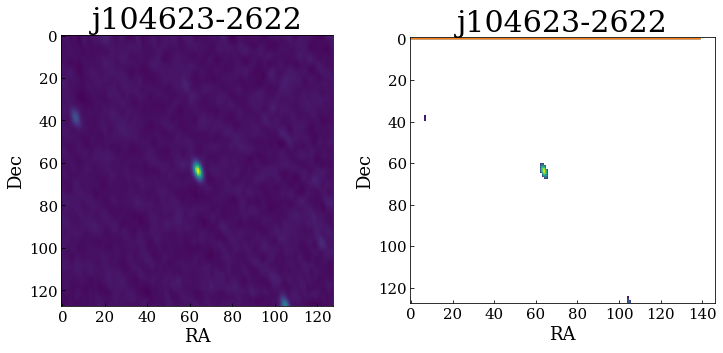

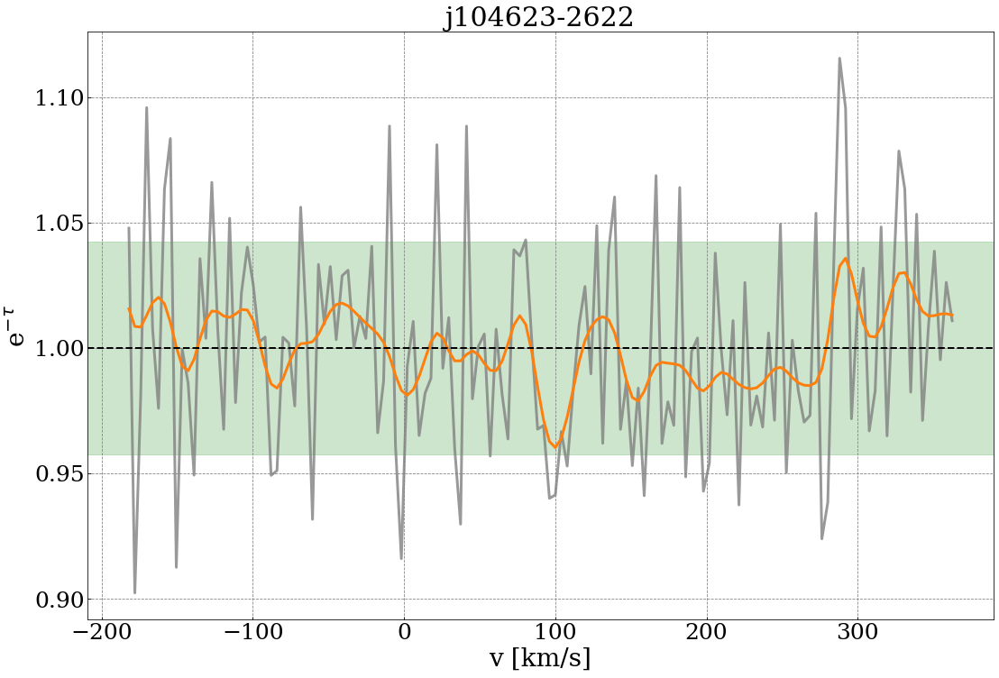

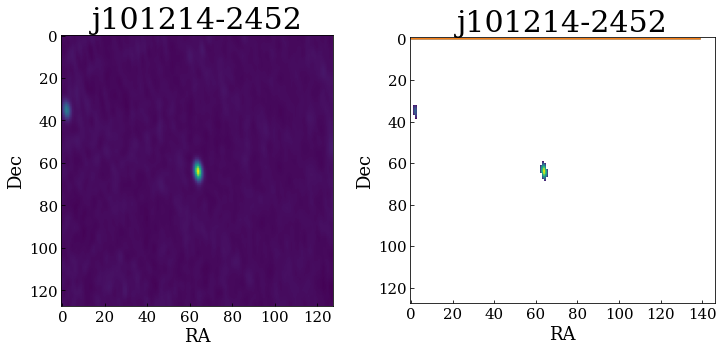

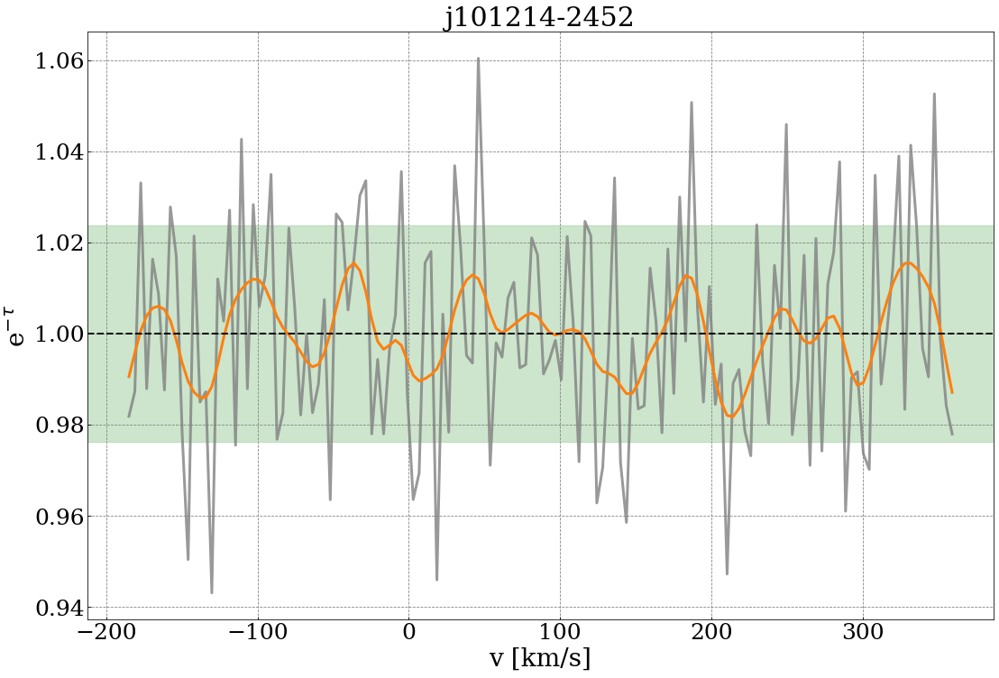

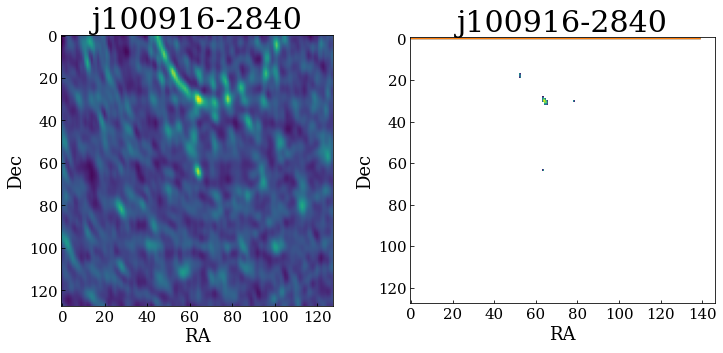

...

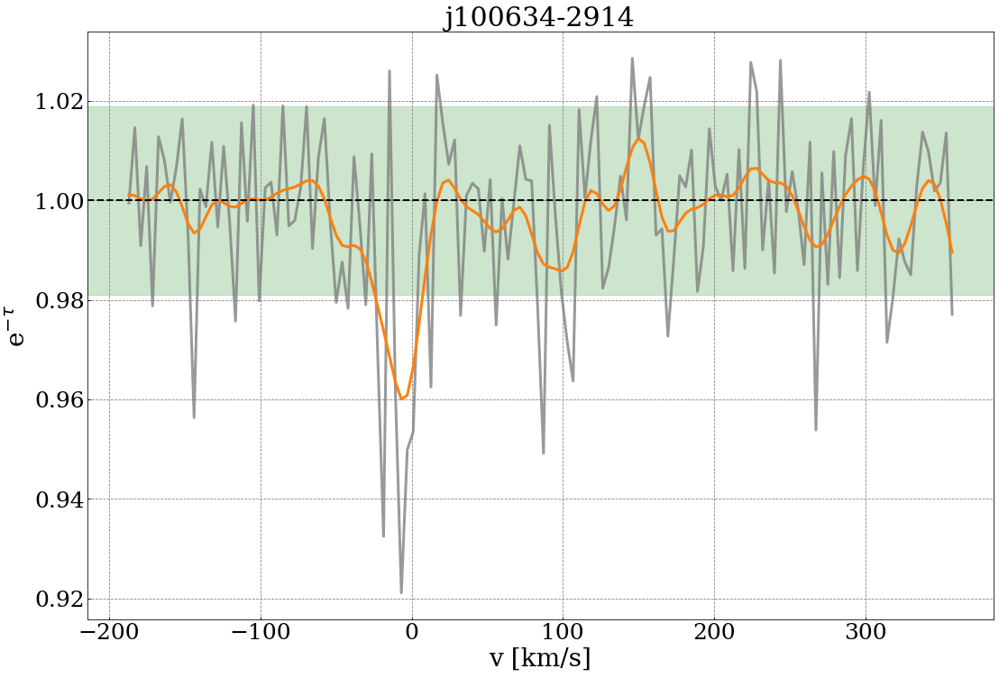

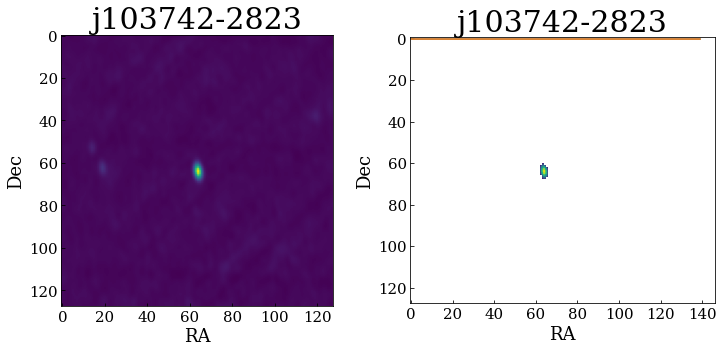

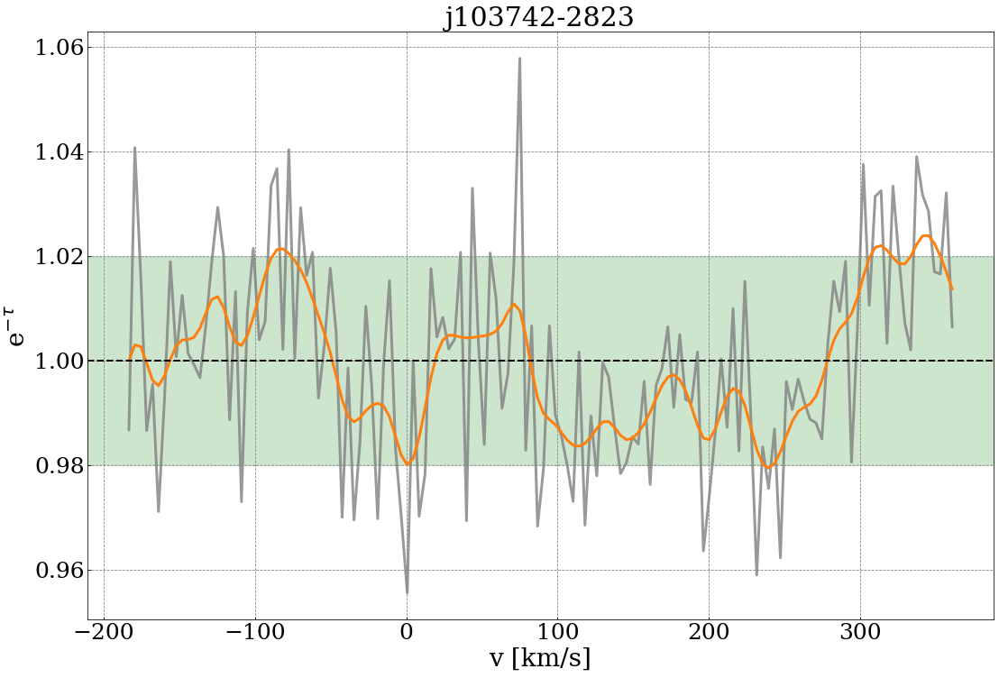

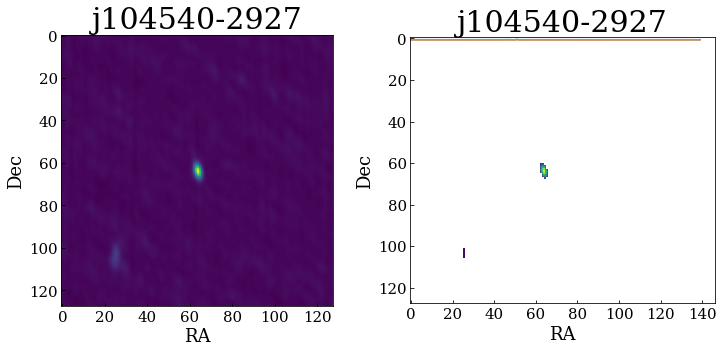

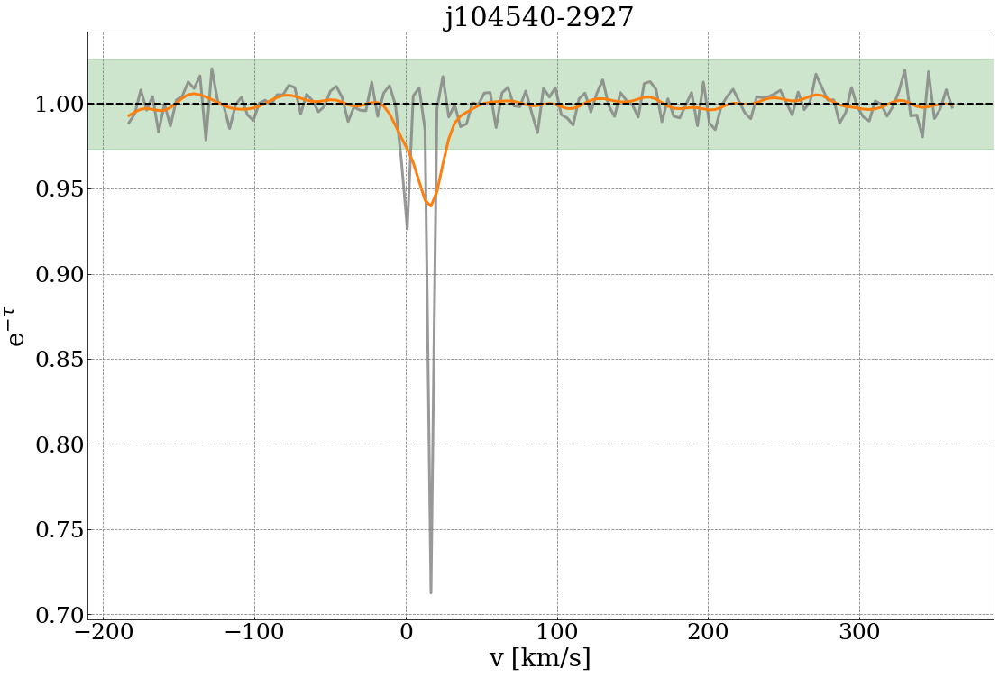

In [11]:
atca_files = os.listdir('/Users/Denes/Research/High_lat_HI/ATCA_data/data_cubes_4k/hydra/')
detection = []

#for i in atca_files[0:3]:
for i in atca_files:
    plot_spectra_hydra_4k(i)
    
print('number of detections:', len(detection))

In [12]:
def plot_spectra_norma_4k(atca_file):
    cube = SpectralCube.read('/Users/Denes/Research/High_lat_HI/ATCA_data/data_cubes_4k/norma/{}'.format(atca_file))  # Open the FITS file for reading
    
    atca = fits.open('/Users/Denes/Research/High_lat_HI/ATCA_data/data_cubes_4k/norma/{}'.format(atca_file))  # Open the FITS file for reading
    d_atca = atca[0].data
    h_atca = atca[0].header
    w_atca = WCS(h_atca, atca)
    
    d_atca = d_atca[0,:,:,:] # cut polarization axix
    d_atca_av = np.mean(d_atca, axis=0)  # average cube along the velocity axis
    
    # rms and maximum of the image
    print('max image:', np.max(d_atca_av))
    rms = np.sqrt(np.mean(d_atca_av**2))
    print('rms:', rms)
    
    d_atca_av_2 = np.copy(d_atca_av)
    
    d_atca_av_2[d_atca_av_2 < 5*rms] = 'nan'
    
    signal = np.where(d_atca_av_2 > 0)
    print(signal[0])
 
    # plot average data cube image
    fig = plt.figure(figsize=(12,5))
    
    ax = fig.add_subplot(1,2,1)
    plt.title('{}'.format(atca_file[:12]), fontsize=30)
    plt.imshow(d_atca_av)
    ax.set_xlabel('RA', size=18,family='serif')
    ax.set_ylabel('Dec', size=18,family='serif')
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    
    ax = fig.add_subplot(1,2,2)
    plt.title('{}'.format(atca_file[:12]), fontsize=30)
    plt.imshow(d_atca_av_2)
    ax.set_xlabel('RA', size=18,family='serif')
    ax.set_ylabel('Dec', size=18,family='serif')
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)

    fig.savefig('/Users/Denes/Research/High_lat_HI/ATCA_data/maps/{}_4k_map.png'.format(atca_file[:-5]))
    
    c_atca = SkyCoord(ra=h_atca['CRVAL1'], dec=h_atca['CRVAL2'], unit=(u.deg, u.deg))
    pixels_atca = c_atca.to_pixel(w_atca)
    g = Gaussian1DKernel(2.0)
    
    spectrum = cube[:, int(pixels_atca[1]), int(pixels_atca[0])] 
    rms_spect = np.sqrt(np.mean(spectrum**2))
    print('rms spectrum', rms_spect)
    print('max spectrum', np.max(spectrum))

    # replacing the spectral line with the rms to fit the continuum
    spectrum_2 = np.copy(spectrum)
    spectrum_2[spectrum_2 < rms_spect - (np.max(spectrum)-rms_spect) ] = rms_spect

    #plt.plot(spectrum)
    #plt.plot(spectrum_2)

    vel = cube.spectral_axis
    y = spectrum_2
    x = vel.value/1000
    pars = np.polyfit(x, y, 1)
    p = np.poly1d(pars)

    hismooth = convolve(spectrum, g, boundary='extend')
    tauhi_smooth = hismooth/p(vel.value/1000)
    rms_smooth = np.sqrt(np.mean(tauhi_smooth**2))
    tauhi = spectrum/p(vel.value/1000)
    tauhi = np.array(tauhi)
    tau = np.log(tauhi) * -1.
    std_tauhi = np.std(tauhi)

    #tauhi = hismooth/p(hiv)
    minustauhi = 1. - tauhi

    fig = plt.figure(figsize=(18, 12))
    ax = fig.add_subplot(111)
    plt.title('{}'.format(atca_file[:12]), fontsize=30)
    plt.plot(vel/1000, tauhi, linewidth=3, alpha=0.8, color='gray')
    plt.plot(vel/1000, tauhi_smooth, linewidth=3, color='C1')
    ax.axhspan(1-std_tauhi, 1+std_tauhi, alpha=0.2, color='green')

    plt.axhline(1, color='k', linestyle='--', linewidth=2)
    #plt.axvline(0, color='grey', linestyle='--')
    plt.grid(color='grey', linestyle='--')
    #ax.axhspan(1-rms_smooth, 1+rms_smooth, alpha=0.5, color='lightgrey')
    #ax.axvspan(-10, 3, alpha=0.2, color='green')
    plt.ylabel(r'e$^{-\tau}$', fontsize=28)
    plt.xlabel("v [km/s]", fontsize=28)
    #plt.xlim(-40,40)
    ax.tick_params(axis='both', which='major', labelsize=25)
    fig.savefig('/Users/Denes/Research/High_lat_HI/ATCA_data/spectra_plots/{}_4k_spectra.png'.format(atca_file[:-5]))
    
    df_spectra_tauhi = pd.DataFrame()
    df_spectra_tauhi['velocity'] = vel/1000
    df_spectra_tauhi['Amplitude'] = tauhi
    df_spectra_tauhi.to_csv('./spectra/norma/{}_atca_4k_spectrum_tauhi.txt'.format(atca_file[:-5]), sep='\t')
    
    df_spectra = pd.DataFrame()
    df_spectra['velocity'] = vel/1000
    df_spectra['Amplitude'] = spectrum
    df_spectra.to_csv('./spectra/norma/{}_atca_4k_spectrum.txt'.format(atca_file[:-5]), sep='\t')
    

max image: 0.088095516
rms: 0.004409599
[  0   0   1   1  36  36  37  37  37  37  37  38  38  38  38  38  38  38
  38  39  39  39  39  39  39  39  39  40  40  40  40  40  40  40  40  41
  41  82 108 108 109 109 109 109 109 110 110 110 110 110 111 111 111 111
 111 112 112 112 123 123 123 123 123 123 124 124 124 124 124 124 124 125
 125 125 125 125 125 125 125 125 125 126 126 126 126 126 126 126 126 126
 126 127 127 127 127 127 127 127 127 127 127 128 128 128 128 128 128 128
 128 128 128 129 129 129 129 129 129 129 129 129 129 130 130 130 130 130
 130 130 130 130 131 131 131 131 131 131 131 131 132 132 132 132 132 132
 141 142 142 143 143 143 162 197 197 198 198 199 199 237 237 237 238 238
 238 238 238 239 239 239 239 239 239 240 240 240 240 240 240 241 241 241
 241 241 242 242 242 242]
rms spectrum 0.07961934059858322 Jy / beam
max spectrum 0.09495677053928375 Jy / beam


max image: 0.17756099
rms: 0.004986329
[60 60 61 61 61 62 62 62 62 62 62 63 63 63 63 63 63 63 64 64 64 64 64 64
 64 65 65 65 65 65 65 65 66 66 66 66 66 66 66 67 67 67 67 67 67 68 68 68]
rms spectrum 0.17832064628601074 Jy / beam
max spectrum 0.2108900249004364 Jy / beam


max image: 0.12818792
rms: 0.0026082192
[62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66 66 66 66]
rms spectrum 0.08700273185968399 Jy / beam
max spectrum 0.10220232605934143 Jy / beam


max image: 0.25606912
rms: 0.0046760286
[62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66 66 66 66]
rms spectrum 0.18485680222511292 Jy / beam
max spectrum 0.1989283263683319 Jy / beam


max image: 0.20567259
rms: 0.0064186244
[ 60  60  61  61  61  61  62  62  62  62  62  63  63  63  63  64  64  64
  64  64  65  65  65  65  65  66  66  66  66  67 124 125 125 126 126 126
 126 127 127 127 127 127]
rms spectrum 0.04402179270982742 Jy / beam
max spectrum 0.05914301797747612 Jy / beam


max image: 0.14626499
rms: 0.003792107
[ 0  0  1  1  2 62 62 62 62 63 63 63 63 64 64 64 64 64 65 65 65 65 66 66
 66]
rms spectrum 0.10016236454248428 Jy / beam
max spectrum 0.11192606389522552 Jy / beam


max image: 0.19491485
rms: 0.004763723
[61 61 61 62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66 66
 66 66 67 67 67 68 68]
rms spectrum 0.09167145192623138 Jy / beam
max spectrum 0.10277201235294342 Jy / beam


max image: 0.7838165
rms: 0.03420669
[56 56 57 57 57 57 58 58 58 58 58 59 59 59 59 59 59 60 60 60 60 60 61 61
 61 61 61 61 62 62 62 62 62 62 63 63 63 63 63 63 63 64 64 64 64 64 64 65
 65 65 65 65 65 66 66 66 66 66 66 67 67 67 67 67 67 68 68 68 68 68 68 69
 69 69 69 69 69 70 70 70 70 70 70 71 71 71 71 72 72 72 73 73]
rms spectrum 0.4540485441684723 Jy / beam
max spectrum 0.4943801760673523 Jy / beam


max image: 0.12184188
rms: 0.004025121
[ 63  63  64  64  64  64  65  65  65  65  65  66  66  66  66  66  67  67
  67  67 117 118 118 118]
rms spectrum 0.04299214109778404 Jy / beam
max spectrum 0.06255248934030533 Jy / beam


max image: 0.33836752
rms: 0.009122619
[60 60 61 61 61 61 61 62 62 62 62 62 62 62 63 63 63 63 63 63 63 63 64 64
 64 64 64 64 64 65 65 65 65 65 65 65 66 66 66 66 66 66 67 67 67 67 67 68
 68]
rms spectrum 0.18847551941871643 Jy / beam
max spectrum 0.20820310711860657 Jy / beam


max image: 0.8518837
rms: 0.014767348
[62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66 66 66 66]


<ipython-input-12-a78e64bc8697>:25: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(12,5))


rms spectrum 0.6144447922706604 Jy / beam
max spectrum 0.6413436532020569 Jy / beam


max image: 0.26087627
rms: 0.004814049
[62 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66 66 66 66 67]
rms spectrum 0.1803843230009079 Jy / beam
max spectrum 0.1953437775373459 Jy / beam


max image: 0.23104994
rms: 0.0077318796
[30 30 31 31 31 32 32 32 32 33 33 33 33 34 34 34 34 35 35 35 35 36 36 36
 37 37 57 57 58 58 58 58 59 59 59 59 59 60 60 60 60 60 60 61 61 61 61 61
 61 61 62 62 62 62 62 62 62 62 63 63 63 63 63 63 63 63 64 64 64 64 64 64
 64 64 65 65 65 65 65 65 65 65 66 66 66 66 66 66 67 67 67 67 67 68 68 68]
rms spectrum 0.12352502346038818 Jy / beam
max spectrum 0.13986365497112274 Jy / beam


max image: 0.13228475
rms: 0.019227367
[ 41  41  41  42  42  42  43  43  58  65  65  66  95 105 106 107 108 109
 110 110 110 111 121 123 124 124 125 126]
rms spectrum 0.05439506471157074 Jy / beam
max spectrum 0.07192163914442062 Jy / beam


max image: 0.13166887
rms: 0.0027671035
[ 62  62  62  63  63  63  63  63  64  64  64  64  64  65  65  65  65  65
  66  66  66 109 109 110 110 110 110 111 111 111 111 112 112 112 112]
rms spectrum 0.0990055650472641 Jy / beam
max spectrum 0.1213887482881546 Jy / beam


max image: 0.11220167
rms: 0.0025694326
[62 62 62 62 62 62 63 63 63 63 63 63 63 63 64 64 64 64 64 64 64 65 65 65
 65 65 66 66 66 66 92 92 92 93 93 93 93 94 94 94 94 95 95 95 95 96 96 96]
rms spectrum 0.08190609514713287 Jy / beam
max spectrum 0.0963943749666214 Jy / beam


max image: 0.15851423
rms: 0.0029518178
[62 62 62 62 63 63 63 63 63 63 64 64 64 64 64 64 64 65 65 65 65 65 65 66
 66 66 66]
rms spectrum 0.13196830451488495 Jy / beam
max spectrum 0.14078818261623383 Jy / beam


max image: 0.08022878
rms: 0.0030323828
[124 124 124 124 125 125 125 125 125 125 125 125 126 126 126 126 126 126
 126 126 126 127 127 127 127 127 127 127 127 127 127 127 128 128 128 128
 128 128 128 128 128 128 128 129 129 129 129 129 129 129 129 129 129 129
 130 130 130 130 130 130 130 130 130 131 131 131 131 131 131 131 131 132
 132 132 132 132 132 215 216 216 216 216 216 217 217 222 222 222 222 223
 223 223 223 223 224 224 224 224 224 225 225 225 225 225 225 226 226 226
 226 226 227 227 227 227]
rms spectrum 0.07628380507230759 Jy / beam
max spectrum 0.0891791582107544 Jy / beam


max image: 0.4223771
rms: 0.0234612
[  2   3   3  38  38  39  39  40  58  58  59  59  59  60  60  60  60  61
  61  61  61  61  62  62  62  62  63  63  63  63  63  63  63  64  64  64
  64  64  65  65  65  65  66  66  66  66  67  67  67  67  68  72  75  75
  76  76  76  77  77  78  78  95  96 107 112 113 113 114 114 115 115 116
 116 118 119 120 120 121 121 122]
rms spectrum 0.35790762305259705 Jy / beam
max spectrum 0.38115420937538147 Jy / beam


max image: 0.13129327
rms: 0.004191311
[60 60 61 61 61 62 62 62 62 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66
 66 66 66 66 67 67 67 67 68 68 68 69 69 74 75]
rms spectrum 0.07723204046487808 Jy / beam
max spectrum 0.09047296643257141 Jy / beam


max image: 0.1103988
rms: 0.0032790068
[ 62  62  62  63  63  63  63  63  64  64  64  64  64  65  65  65  65  65
  66  66  66  90  90  90  91  91  91  92 105 105 105 105 106 106 106 106
 106 106 106 107 107 107 107 107 107 107 108 108 108 108 108 108 109 109
 109 109 109]
rms spectrum 0.07964126020669937 Jy / beam
max spectrum 0.09395774453878403 Jy / beam


max image: 3.2150342
rms: 0.09395441
[56 56 57 57 57 58 58 59 59 59 60 60 60 60 61 61 61 61 62 62 62 62 63 63
 63 63 64 64 64 65 65 65 65 66 66 66 66 67 67 67 67 68 68 68 68 69 69 69
 70 70 71 71 71 72 72]
rms spectrum 1.9011845588684082 Jy / beam
max spectrum 1.9352293014526367 Jy / beam


max image: 0.09142236
rms: 0.0038599311
[ 85  85  85  85  86  86  86  86  87  87  87  87  87  88  88  88  88  88
  89  89  89 124 124 124 124 124 125 125 125 125 125 125 125 125 125 126
 126 126 126 126 126 126 126 126 126 126 127 127 127 127 127 127 127 127
 127 127 127 128 128 128 128 128 128 128 128 128 128 128 128 129 129 129
 129 129 129 129 129 129 129 129 130 130 130 130 130 130 130 130 130 130
 131 131 131 131 131 131 131 132 132 132]
rms spectrum 0.08965888619422913 Jy / beam
max spectrum 0.11523657292127609 Jy / beam


max image: 0.09496484
rms: 0.0035001268
[ 56  56  56  57  57  57  57  58  58  58  58  58  59  59  59  59  59  60
  60  60  60  61  61  61  65  65  65  66  66  66  67  67  67  67  68  68
  68  68  69  69 126 126 126 126 127 127 127 127 127 127 128 128 128 128
 128 128 129 129 129 129 129 129 130 130 130 130 130 130 131 131 131 131
 131 132 132 164 164 164 164 164 164 165 165 165 165 165 165 165 165 165
 165 166 166 166 166 166 166 166 166 166 166 166 166 167 167 167 167 167
 167 167 167 167 167 167 167 168 168 168 168 168 168 168 168 168 168 168
 168 169 169 169 169 169 169 169 169 169 169 169 169 170 170 170 170 170
 170 170 170 170 170 170 171 171 171 171 171 171 171 171 171 171 172 172
 172 172 172 172 172 172 173 173 173 173]
rms spectrum 0.04371653497219086 Jy / beam
max spectrum 0.05797141045331955 Jy / beam


max image: 0.136473
rms: 0.0028357932
[62 62 62 62 63 63 63 63 63 63 63 64 64 64 64 64 64 64 65 65 65 65 65 65
 66 66 66 66]
rms spectrum 0.12142766267061234 Jy / beam
max spectrum 0.1268184334039688 Jy / beam


max image: 0.33996695
rms: 0.057470948
[ 20  21  22  23  24  25  26  27  28  29  30  31  32  32  33  34  35  36
  37  37  38  39  39  40  41  41  42  43  44  44  45  46  46  47  48  48
  49  50  51  51  52  53  53  54  55  55  56  56  57  58  58  59  60  60
  61  62  62  63  63  64  65  65  66  67  67  68  69  70  70  71  72  72
  73  74  74  75  76  77  77  78  79  79  80  81  81  82  83  84  84  85
  86  86  87  88  89  90  91  91  92  93  94  95  96  97  98  98  99 100
 101 102 103 104 106 107 108 109]
rms spectrum 0.2859312891960144 Jy / beam
max spectrum 0.6360704898834229 Jy / beam


<ipython-input-12-a78e64bc8697>:72: RuntimeWarning: invalid value encountered in log
  tau = np.log(tauhi) * -1.


max image: 0.24867778
rms: 0.0067164195
[ 9 10 62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66 66 66 87
 87 88 88 88 88 88 89 89 89 89 89 89 90 90 90 90 90 90 91 91 91 91 91 91
 91 92 92 92 92 92 92 92 93 93 93 93 93 93 93 94 94 94 94 94 94 94 95 95
 95 95 95 95 96 96 96 96 96 97 97 97]
rms spectrum 0.18006905913352966 Jy / beam
max spectrum 0.19514532387256622 Jy / beam


max image: 0.73109454
rms: 0.013337273
[62 62 62 62 63 63 63 63 63 64 64 64 64 64 64 65 65 65 65 65 66 66 66 66
 66 67 67 67 67]
rms spectrum 0.5366967916488647 Jy / beam
max spectrum 0.5572757720947266 Jy / beam


max image: 0.3623953
rms: 0.008246192
[62 62 62 62 62 63 63 63 63 63 63 63 64 64 64 64 64 64 64 65 65 65 65 65
 65 65 66 66 66 66 66]
rms spectrum 0.3095056414604187 Jy / beam
max spectrum 0.3302267789840698 Jy / beam


max image: 0.07088726
rms: 0.0017372121
[ 29  62  62  62  63  63  63  63  63  63  64  64  64  64  64  64  64  65
  65  65  65  65  65  66  66  66  66  92  92 113 113 114 114 114 114 114
 115 115 115 115 115 115 116 116 116 116 116 116 117 117 117 117 118 118]
rms spectrum 0.06417015939950943 Jy / beam
max spectrum 0.0732114389538765 Jy / beam


max image: 0.14031465
rms: 0.0029542649
[62 62 62 62 62 63 63 63 63 63 63 63 64 64 64 64 64 64 64 65 65 65 65 65
 65 66 66 66 66]
rms spectrum 0.12476158142089844 Jy / beam
max spectrum 0.13547922670841217 Jy / beam


max image: 5.3626
rms: 0.10684025
[61 61 61 62 62 62 62 63 63 63 63 64 64 64 64 64 65 65 65 65 66 66 66 66
 67 67 67]
rms spectrum 3.6393933296203613 Jy / beam
max spectrum 3.689509868621826 Jy / beam


max image: 0.17198783
rms: 0.0030667535
[62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66 66 66 66]
rms spectrum 0.123167484998703 Jy / beam
max spectrum 0.13728739321231842 Jy / beam


max image: 5.0506353
rms: 0.14337629
[56 57 57 58 58 59 59 59 60 60 60 60 61 61 61 62 62 62 62 63 63 63 64 64
 64 64 65 65 65 66 66 66 66 67 67 67 68 68 68 68 69 69 69 70 70 71 71 72]
rms spectrum 4.515301704406738 Jy / beam
max spectrum 4.574484348297119 Jy / beam


max image: 0.14155757
rms: 0.0027421392
[10 10 11 11 11 11 12 12 12 12 13 13 13 62 62 62 63 63 63 63 63 64 64 64
 64 64 65 65 65 65 65 66 66 66]
rms spectrum 0.10353150218725204 Jy / beam
max spectrum 0.1164262518286705 Jy / beam


max image: 0.17363314
rms: 0.0035842448
[28 29 29 29 30 30 63 63 63 64 64 64 64 64 65 65 65 65 65 66 66 66 66 66
 67 67 67 67 67 68 68]
rms spectrum 0.06641200184822083 Jy / beam
max spectrum 0.07999932020902634 Jy / beam


max image: 0.16047479
rms: 0.00444901
[  3   3   3  62  62  62  63  63  63  63  63  63  64  64  64  64  64  64
  65  65  65  65  65  66  66  66  66 122]
rms spectrum 0.11705808341503143 Jy / beam
max spectrum 0.12818996608257294 Jy / beam


max image: 0.39434934
rms: 0.009865247
[62 62 62 63 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66 66 66]
rms spectrum 0.2875836491584778 Jy / beam
max spectrum 0.3027614951133728 Jy / beam


max image: 0.10704734
rms: 0.0036241617
[ 68  68  69  69  69  70  70  70  71  71  72  72  73  73  73  73  74  74
  74  74  75  75  75  75  76  76  76  76  77  77  77  78  91  91  91  92
  92  92  92  93  93  93  93  93  94  94  94  94  94  95  95  95  95  96
  96  96 122 122 122 122 122 122 122 123 123 123 123 123 123 123 123 123
 124 124 124 124 124 124 124 124 124 124 125 125 125 125 125 125 125 125
 125 125 125 126 126 126 126 126 126 126 126 126 126 126 127 127 127 127
 127 127 127 127 127 127 127 128 128 128 128 128 128 128 128 128 128 128
 129 129 129 129 129 129 129 129 129 129 130 130 130 130 130 130 130 130
 130 131 131 131 131 131 131 131 131 131 132 132 132 132 132 132 132 132
 132 133 133 133 133 133 133 133 133 133 134 134 134 134 134 134 134 134
 135 135 135 135 135 135 136 136 136 136 175 175]
rms spectrum 0.07940005511045456 Jy / beam
max spectrum 0.09343884885311127 Jy / beam


max image: 1.5116442
rms: 0.030727953
[60 60 61 61 61 62 62 62 62 63 63 63 63 64 64 64 64 64 65 65 65 65 65 66
 66 66 66 67 67 67 68]
rms spectrum 0.9348124265670776 Jy / beam
max spectrum 0.9663697481155396 Jy / beam


max image: 0.30865344
rms: 0.0089582335
[62 63 63 63 63 63 63 63 63 64 64 64 64 64 64 64 64 64 64 65 65 65 65 65
 65 65 65 65 65 66 66 66 66 66 66 66 66 66 66 66 66 67 67 67 67 67 67 67
 67 67 67 68 68 68 68 68 68 69 69 69 69]
rms spectrum 0.06606655567884445 Jy / beam
max spectrum 0.08739667385816574 Jy / beam
number of detections: 0


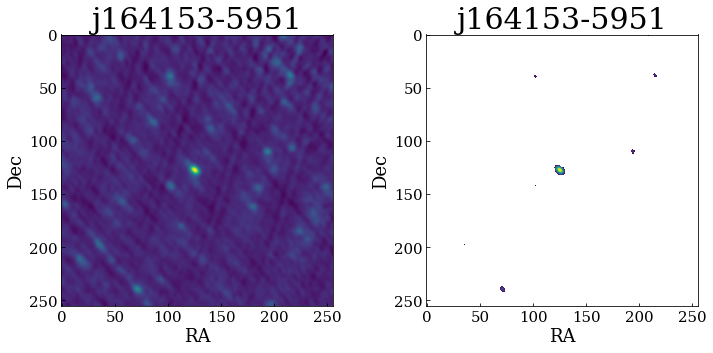

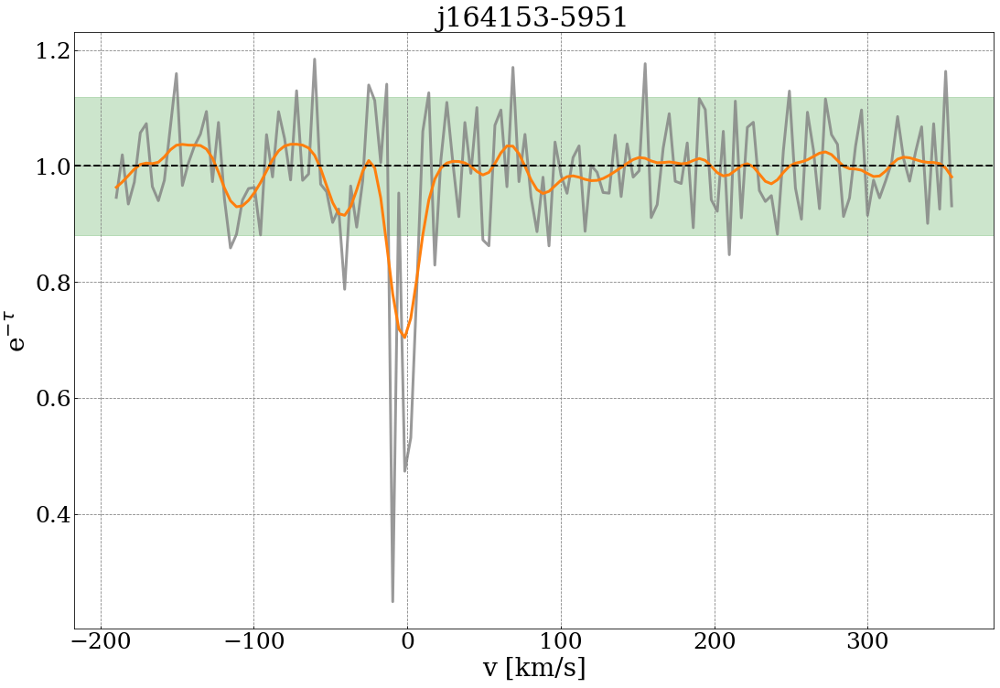

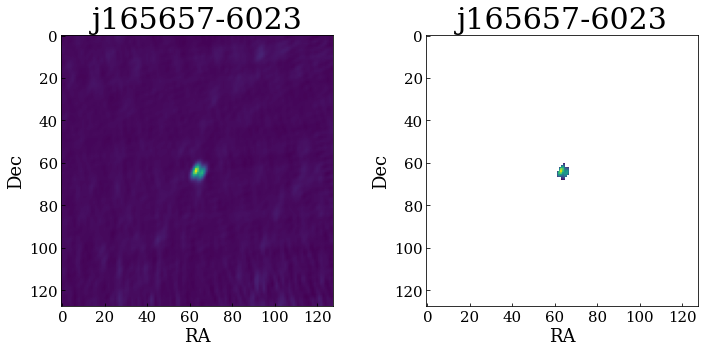

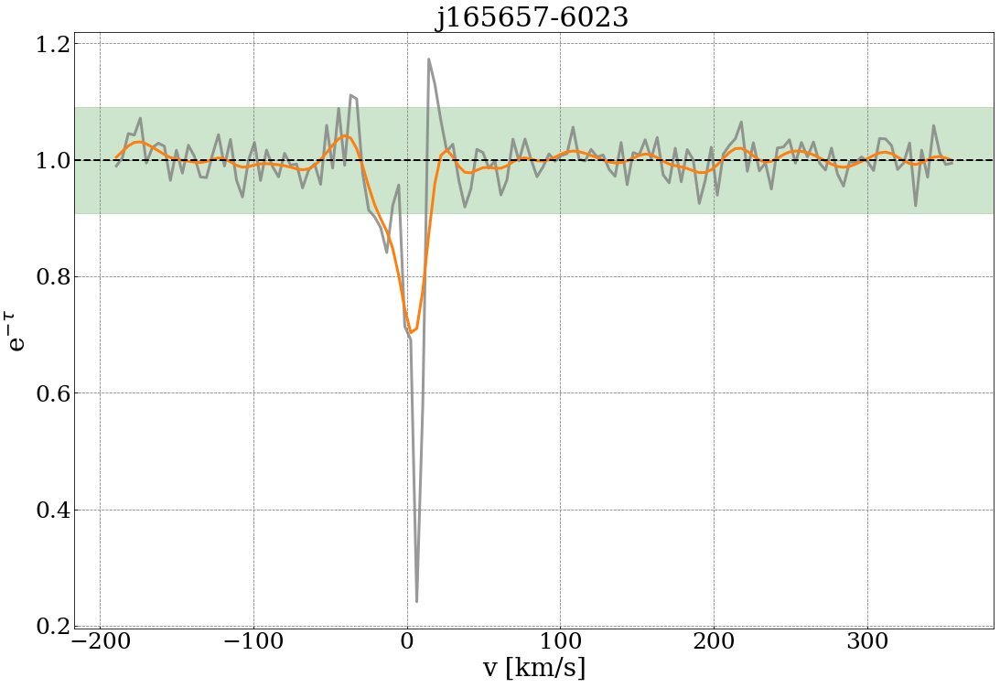

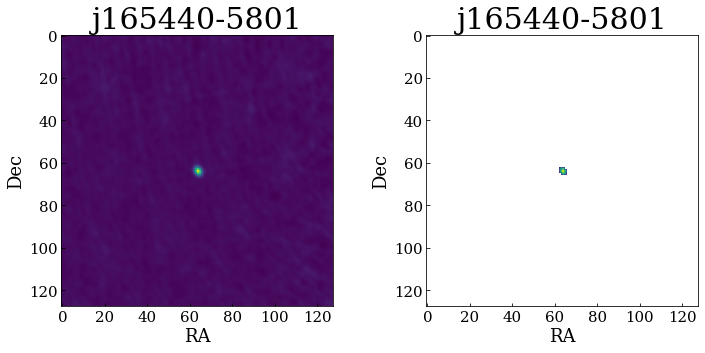

...

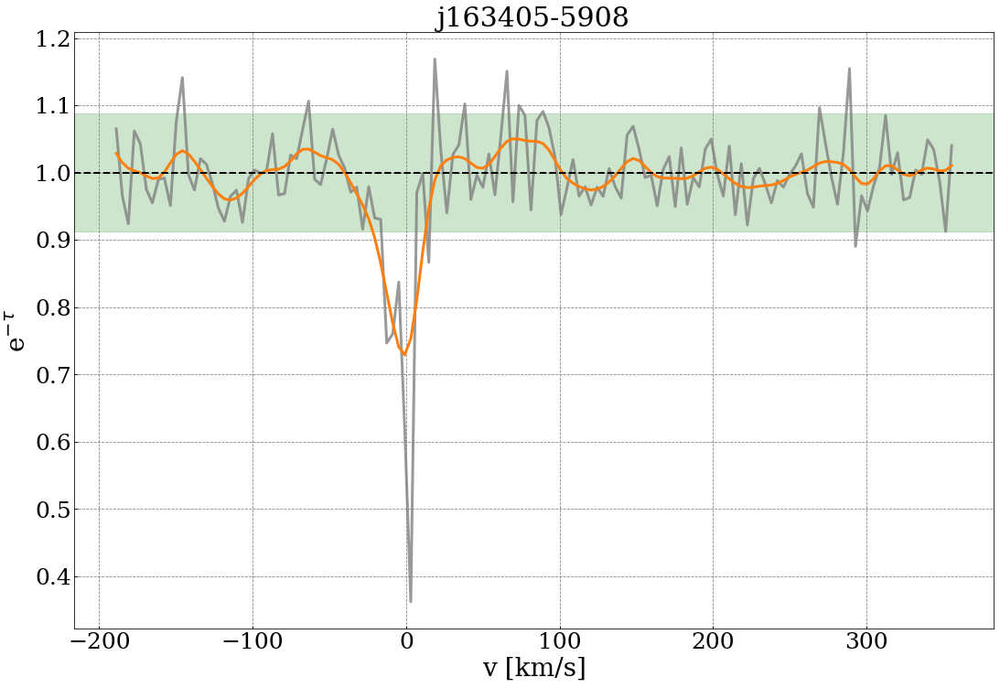

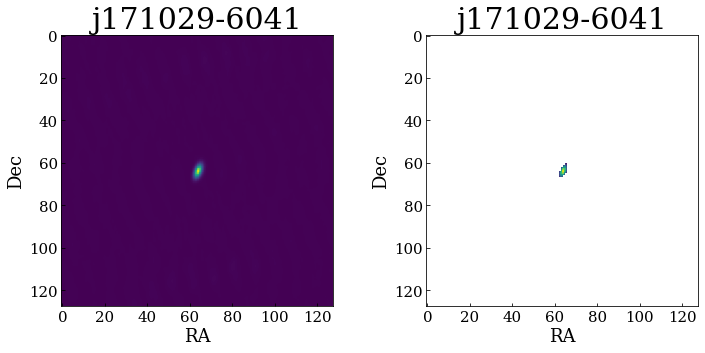

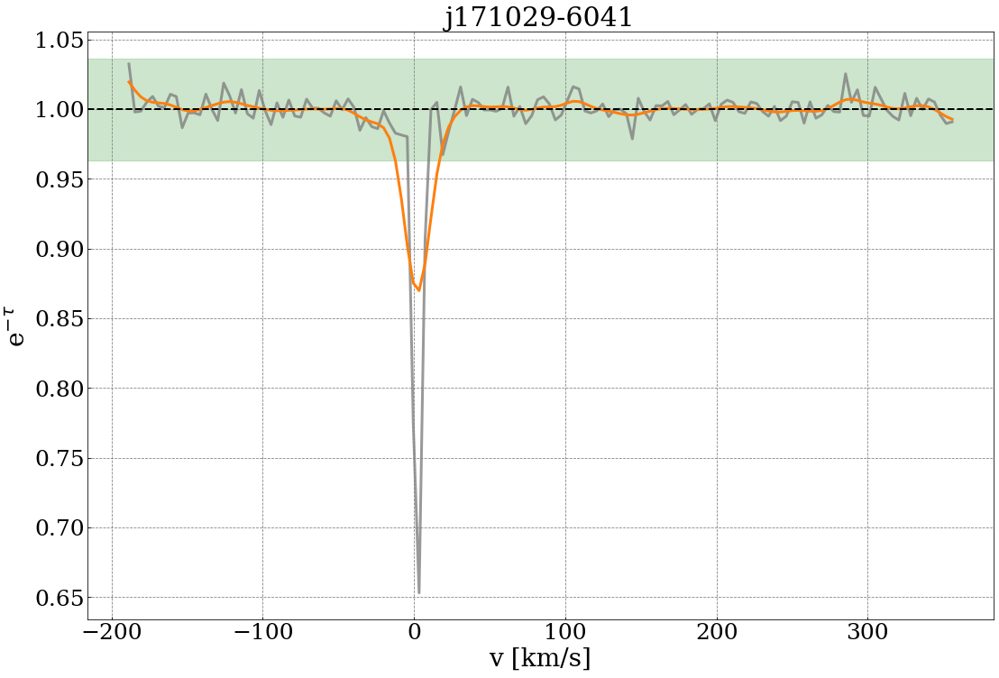

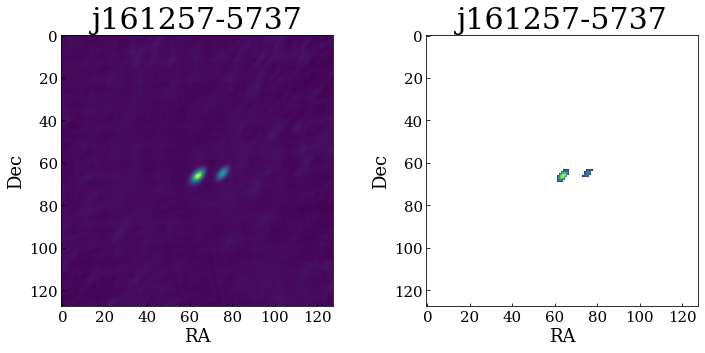

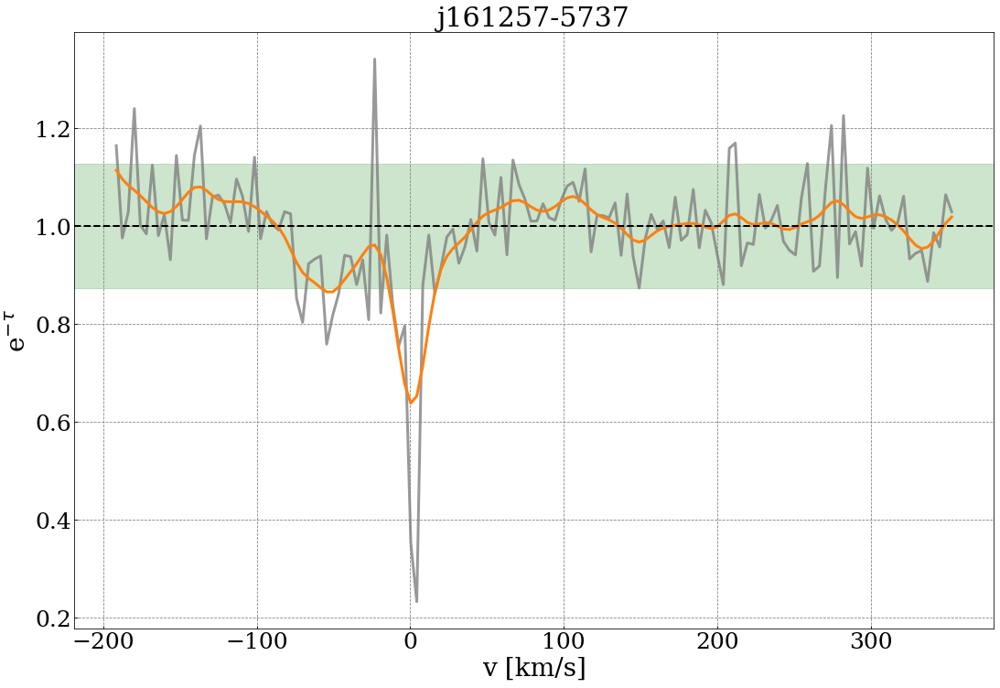

In [13]:
atca_files = os.listdir('/Users/Denes/Research/High_lat_HI/ATCA_data/data_cubes_4k/norma')
detection = []

for i in atca_files:
    try:
        plot_spectra_norma_4k(i)
    except Exception as e:
        print(e)
        continue
        
print('number of detections:', len(detection))